## **homevideosalepredictor - Giancarlo Garbagnati**  

# Modeling with cleaned up data:

In [1]:
# imports
from __future__ import print_function, division
#from bs4 import BeautifulSoup

import os

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

from datetime import datetime

import re # regular expressions
import requests

%matplotlib inline

# modeling imports
from sklearn.cross_validation import train_test_split
from sklearn.ensemble import GradientBoostingRegressor
from sklearn.linear_model import Lasso
from sklearn.pipeline import make_pipeline
from sklearn.preprocessing import PolynomialFeatures
from sklearn.linear_model import LinearRegression
from sklearn.ensemble import RandomForestRegressor
from sklearn.grid_search import GridSearchCV
from sklearn.preprocessing import StandardScaler

/Users/ggarbagnati/anaconda/lib/python3.5/site-packages/sklearn/cross_validation.py:44: DeprecationWarning: This module was deprecated in version 0.18 in favor of the model_selection module into which all the refactored classes and functions are moved. Also note that the interface of the new CV iterators are different from that of this module. This module will be removed in 0.20.
  "This module will be removed in 0.20.", DeprecationWarning)
/Users/ggarbagnati/anaconda/lib/python3.5/site-packages/sklearn/grid_search.py:43: DeprecationWarning: This module was deprecated in version 0.18 in favor of the model_selection module into which all the refactored classes and functions are moved. This module will be removed in 0.20.
  DeprecationWarning)


In [2]:
df1 = pd.read_csv('09-cleaneddata.csv')
df1 = df1.drop(df1.columns[0], axis=1)
#df1.head()

df2 = pd.read_csv('10-cleanedtformdata.csv')
df2 = df2.drop(df2.columns[0], axis=1)
df2.head()

,reldate_bom,dtg2016a,genres,runtime_bom,mpaarating,opwknd,widestrel,directors,prodbud,totalvid,rt_critic,rt_user
0,2006-07-07 00:00:00,559035400,Period Adventure,151,PG-13,179120400.0,4133,Gore Verbinski,225000000,2.425981e+08,0.54,0.72
1,2006-12-22 00:00:00,320409800,Family Adventure,108,PG,40191200.0,3768,Shawn Levy,110000000,1.151701e+08,0.43,0.67
2,2006-06-09 00:00:00,322338600,Animation,116,G,79394500.0,3988,John Lasseter,70000000,2.463390e+08,0.74,0.79
3,2006-05-26 00:00:00,309501600,Action / Adventure,104,PG-13,135693600.0,3714,Brett Ratner,178000000,1.660389e+07,0.58,0.62
4,2006-05-19 00:00:00,287280600,Thriller,149,PG-13,101783900.0,3757,Ron Howard,125000000,7.516178e+07,0.25,0.57


In [3]:
df2['genres'].value_counts()

Comedy                257
Drama                 189
Animation             108
Thriller              103
Horror                 98
Action                 61
Action / Adventure     55
Comedy / Drama         55
Romantic Comedy        51
Fantasy                36
Action Comedy          31
Drama / Thriller       29
Documentary            29
Action Thriller        27
Romance                27
Family Comedy          26
Sci-Fi Action          25
Crime Drama            22
Sports Drama           21
Foreign                20
Family Adventure       19
Adventure              18
Action Drama           17
Music Drama            17
Sci-Fi                 15
Sci-Fi Thriller        15
Family                 14
Horror Thriller        14
Musical                14
Period Drama           12
Horror Comedy          11
Sports Comedy          11
Historical Drama       10
Fantasy Drama          10
Western                 9
Fantasy Comedy          9
Action Horror           9
Sci-Fi Adventure        9
War Drama   

In [3]:
X,y = df2.drop('totalvid', axis=1),df2['totalvid']

0

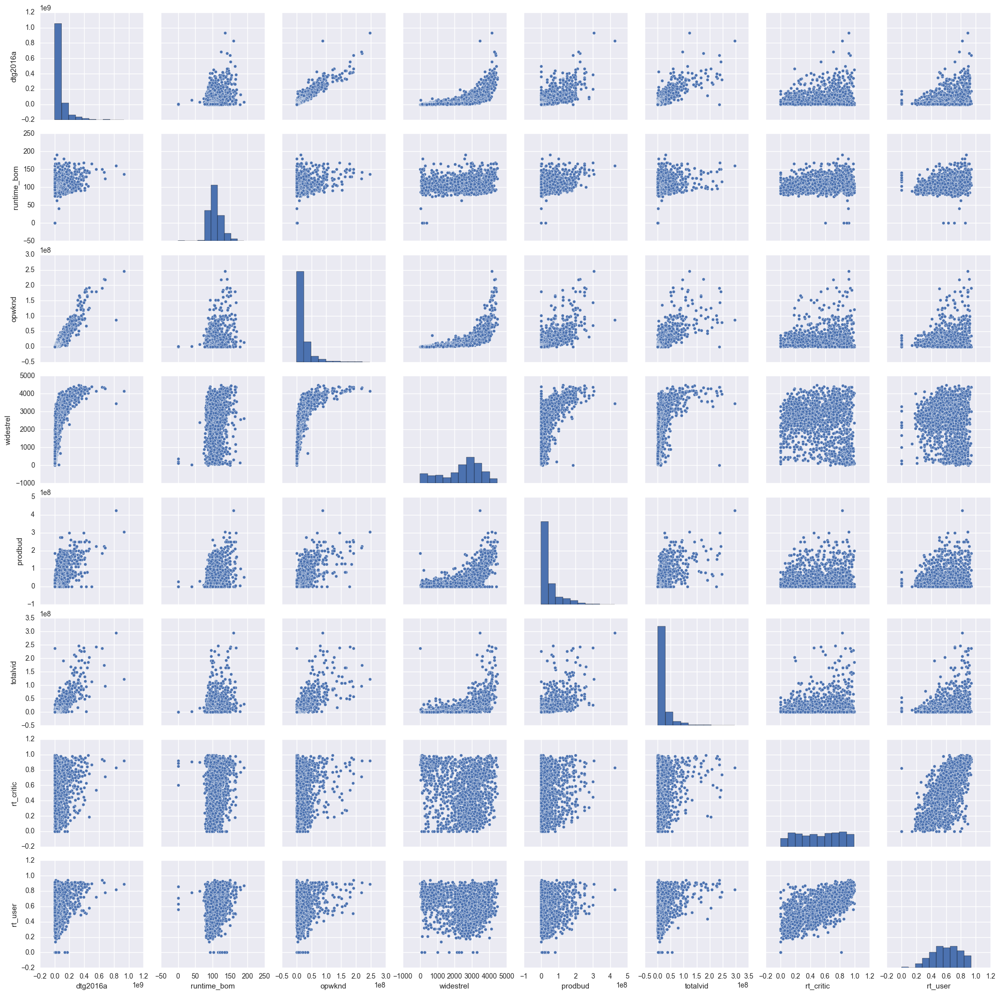

In [5]:
sns.pairplot(df2)
# Doesn't show us the categorical variables

In [5]:
pd.get_dummies(df2, prefix='mpaa_')
# Well that's not what I intended with release date, I'll try converting the release date into a float

,dtg2016a,runtime_bom,opwknd,widestrel,prodbud,totalvid,rt_critic,rt_user,mpaa__2006-01-06 00:00:00,mpaa__2006-01-13 00:00:00,...,mpaa__William Riead,mpaa__Wolfgang Petersen,mpaa__Woody Allen,mpaa__Zach Braff,mpaa__Zach Cregger,mpaa__Zach Helm,mpaa__Zack Snyder,mpaa__Zal Batmanglij,mpaa__Zhang Yimou,mpaa__unlisted
0,559035400,151,179120400.0,4133,225000000,2.425981e+08,0.54,0.72,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,320409800,108,40191200.0,3768,110000000,1.151701e+08,0.43,0.67,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,322338600,116,79394500.0,3988,70000000,2.463390e+08,0.74,0.79,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,309501600,104,135693600.0,3714,178000000,1.660389e+07,0.58,0.62,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,287280600,149,101783900.0,3757,125000000,7.516178e+07,0.25,0.57,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
5,264229400,154,69378400.0,4065,232000000,6.427678e+07,0.76,0.61,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
6,259601100,108,54849500.0,3804,85000000,1.577193e+08,0.75,0.70,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
7,257955700,90,89845800.0,3969,75000000,1.034683e+08,0.57,0.71,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
8,210654000,116,35051300.0,3169,55000000,7.062850e+07,0.67,0.87,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
9,204720200,87,50786700.0,4093,80000000,9.781907e+07,0.75,0.71,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [8]:
df2 = pd.read_csv('10-cleanedtformdata.csv')
df2 = df2.drop(df2.columns[0], axis=1)
df2.head()

X,y = df2.drop('totalvid', axis=1),df2['totalvid']

df2.head()

,reldate_bom,dtg2016a,genres,runtime_bom,mpaarating,opwknd,widestrel,directors,prodbud,totalvid,rt_critic,rt_user
0,2006-07-07 00:00:00,559035400,Period Adventure,151,PG-13,179120400.0,4133,Gore Verbinski,225000000,2.425981e+08,0.54,0.72
1,2006-12-22 00:00:00,320409800,Family Adventure,108,PG,40191200.0,3768,Shawn Levy,110000000,1.151701e+08,0.43,0.67
2,2006-06-09 00:00:00,322338600,Animation,116,G,79394500.0,3988,John Lasseter,70000000,2.463390e+08,0.74,0.79
3,2006-05-26 00:00:00,309501600,Action / Adventure,104,PG-13,135693600.0,3714,Brett Ratner,178000000,1.660389e+07,0.58,0.62
4,2006-05-19 00:00:00,287280600,Thriller,149,PG-13,101783900.0,3757,Ron Howard,125000000,7.516178e+07,0.25,0.57


In [10]:
type(df2['reldate_bom'][0])
# Well actually, it looks like they're strings, so let's try converting them to datetime

str

In [4]:
# Convert the strings to datetime objects
df2['reldate_bom'] = df2['reldate_bom'].apply(pd.to_datetime)

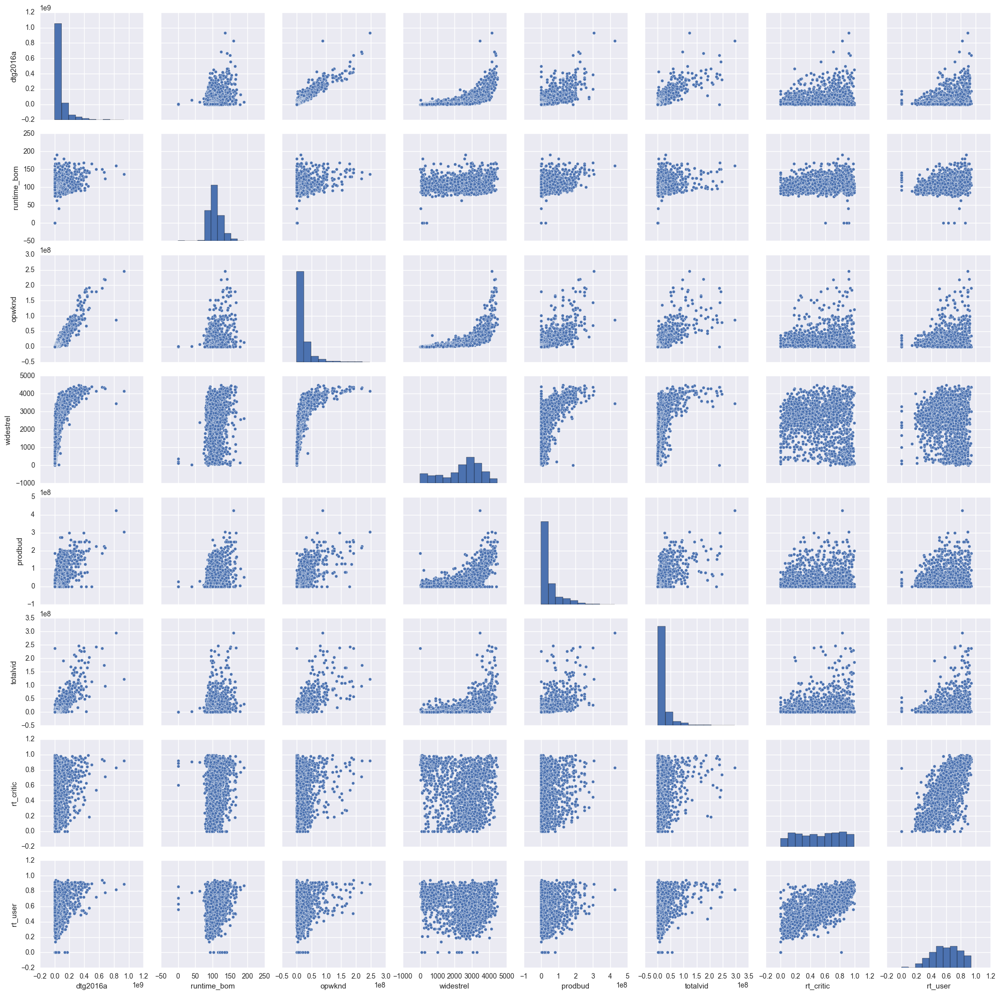

In [16]:
sns.pairplot(df2)
# Still doesn't work with datetime

In [5]:
# convert datetime to float year.month
def datetimeToFloat(dt):
    dtfloat = dt.year
    month = dt.month
    month = (month-1)/12
    dtfloat += month
    return dtfloat

df2['reldate'] = df2['reldate_bom'].apply(datetimeToFloat)

In [9]:
df2['reldate'].sample(20)

370     2008.416667
942     2012.083333
1029    2013.750000
13      2006.833333
695     2010.666667
55      2006.250000
1491    2015.750000
1572    2016.083333
268     2007.666667
250     2007.250000
45      2006.916667
380     2008.583333
1188    2014.083333
751     2010.666667
552     2009.833333
755     2010.666667
60      2006.166667
506     2009.500000
1331    2014.416667
1312    2014.583333
Name: reldate, dtype: float64

In [6]:
df2.drop(['reldate_bom'],axis=1,inplace=True)

In [22]:
df2.head()

,dtg2016a,genres,runtime_bom,mpaarating,opwknd,widestrel,directors,prodbud,totalvid,rt_critic,rt_user,reldate
0,559035400,Period Adventure,151,PG-13,179120400.0,4133,Gore Verbinski,225000000,2.425981e+08,0.54,0.72,2006.500000
1,320409800,Family Adventure,108,PG,40191200.0,3768,Shawn Levy,110000000,1.151701e+08,0.43,0.67,2006.916667
2,322338600,Animation,116,G,79394500.0,3988,John Lasseter,70000000,2.463390e+08,0.74,0.79,2006.416667
3,309501600,Action / Adventure,104,PG-13,135693600.0,3714,Brett Ratner,178000000,1.660389e+07,0.58,0.62,2006.333333
4,287280600,Thriller,149,PG-13,101783900.0,3757,Ron Howard,125000000,7.516178e+07,0.25,0.57,2006.333333


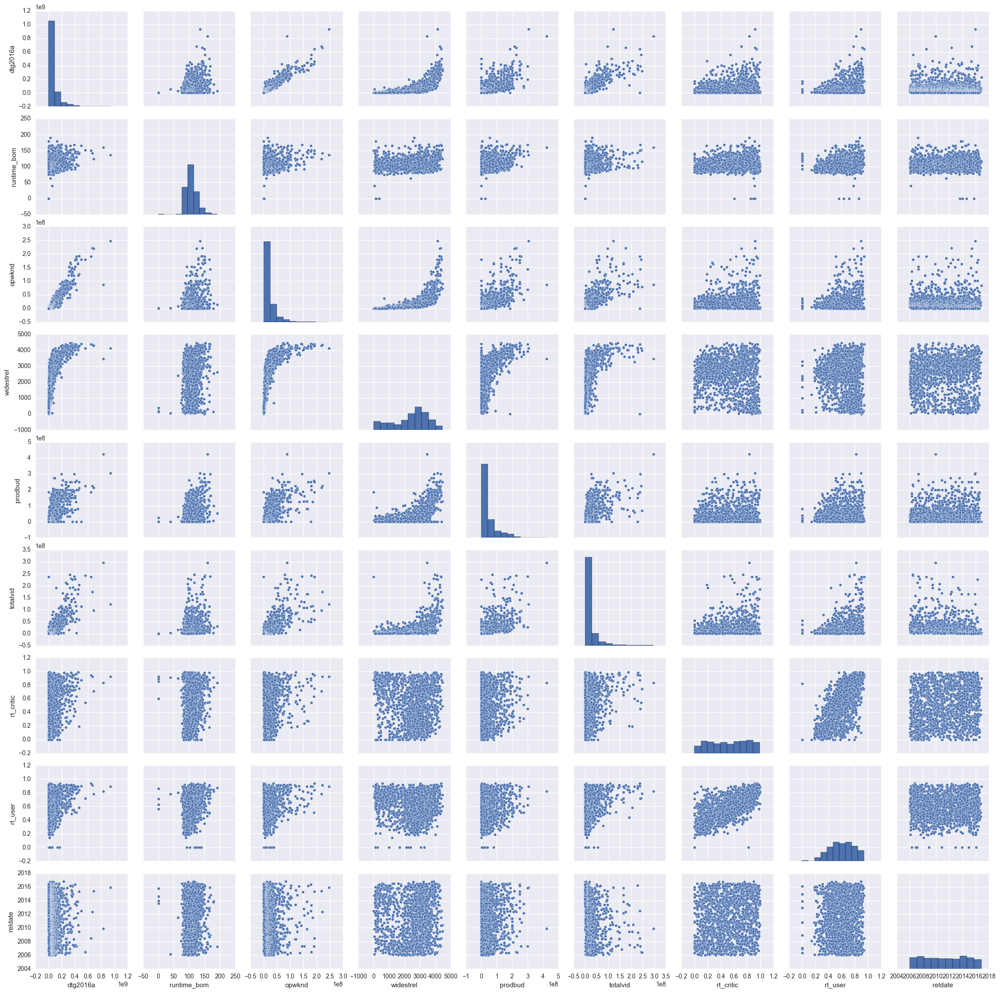

In [23]:
# Now let's try this again
sns.pairplot(df2)
# 

In [18]:
df2['reldate_bom'][0].month

7

In [7]:
df2['widerel_sq'] = df2['widestrel']**2

In [23]:
df2.drop(['widerel_8th'],axis=1,inplace=True)

In [24]:
df2['widerel_4th'] = df2['widestrel']**(4)

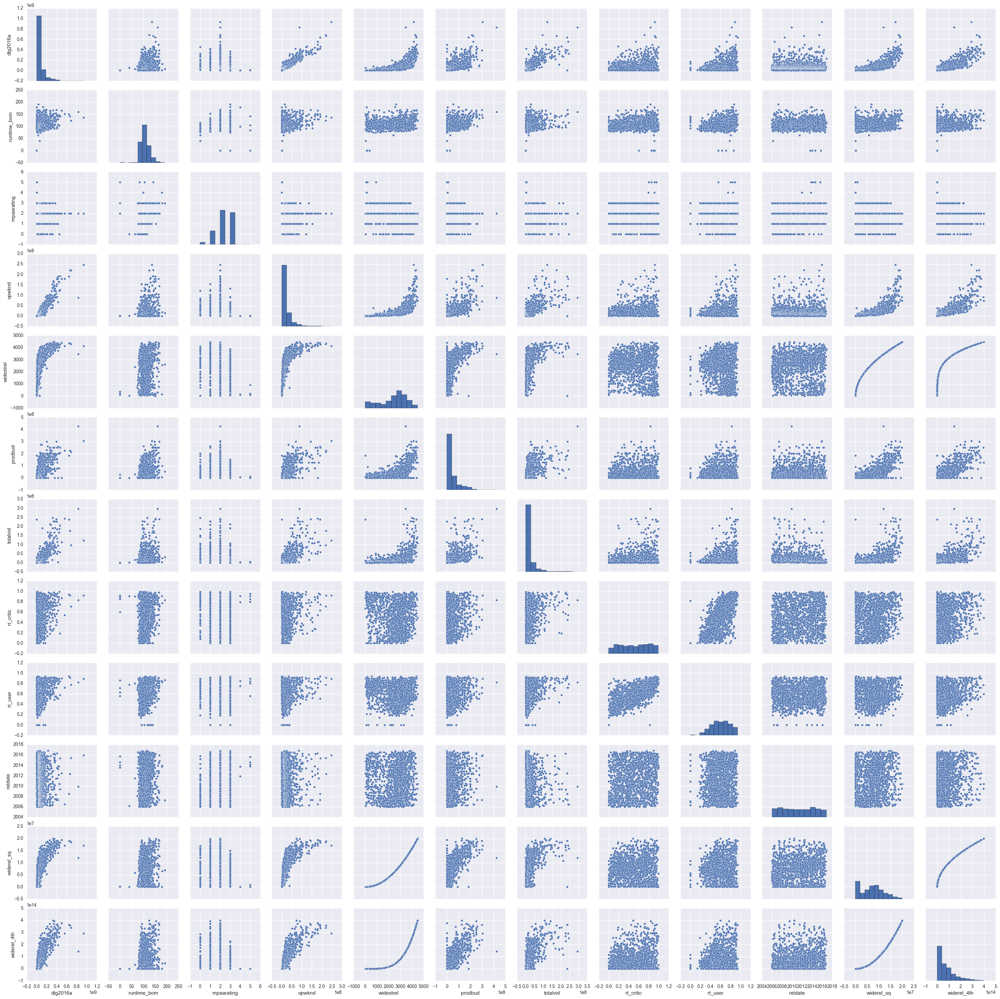

In [25]:
# Now let's try this again
sns.pairplot(df2)

In [12]:
# Let's convert the mpaa ratings to numerical
df2['mpaarating'].value_counts()

PG-13      665
R          617
PG         265
G           43
Unrated      4
NC-17        2
Name: mpaarating, dtype: int64

In [13]:
def mpaaToInt(s):
    if s == 'G':
        return 0
    else:
        if s == 'PG':
            return 1
        else:
            if s == 'PG-13':
                return 2
            else:
                if s == 'R':
                    return 3
                else:
                    if s == 'NC-17':
                        return 4
                    else:
                        return 5

df2['mpaarating'] = df2['mpaarating'].apply(mpaaToInt)

In [55]:
df2['year'] = df2['reldate'].apply(lambda x: int(x))

In [56]:
df2['month'] = df2['reldate'].apply(lambda x: ((x-int(x))*12)+1 )


In [71]:
# Let's also add a column for opwknd/dtg2016a
df2['open_over_total'] = df2['opwknd'] / df5['dtg2016a']

In [14]:
df2['mpaarating'].value_counts()

2    665
3    617
1    265
0     43
5      4
4      2
Name: mpaarating, dtype: int64

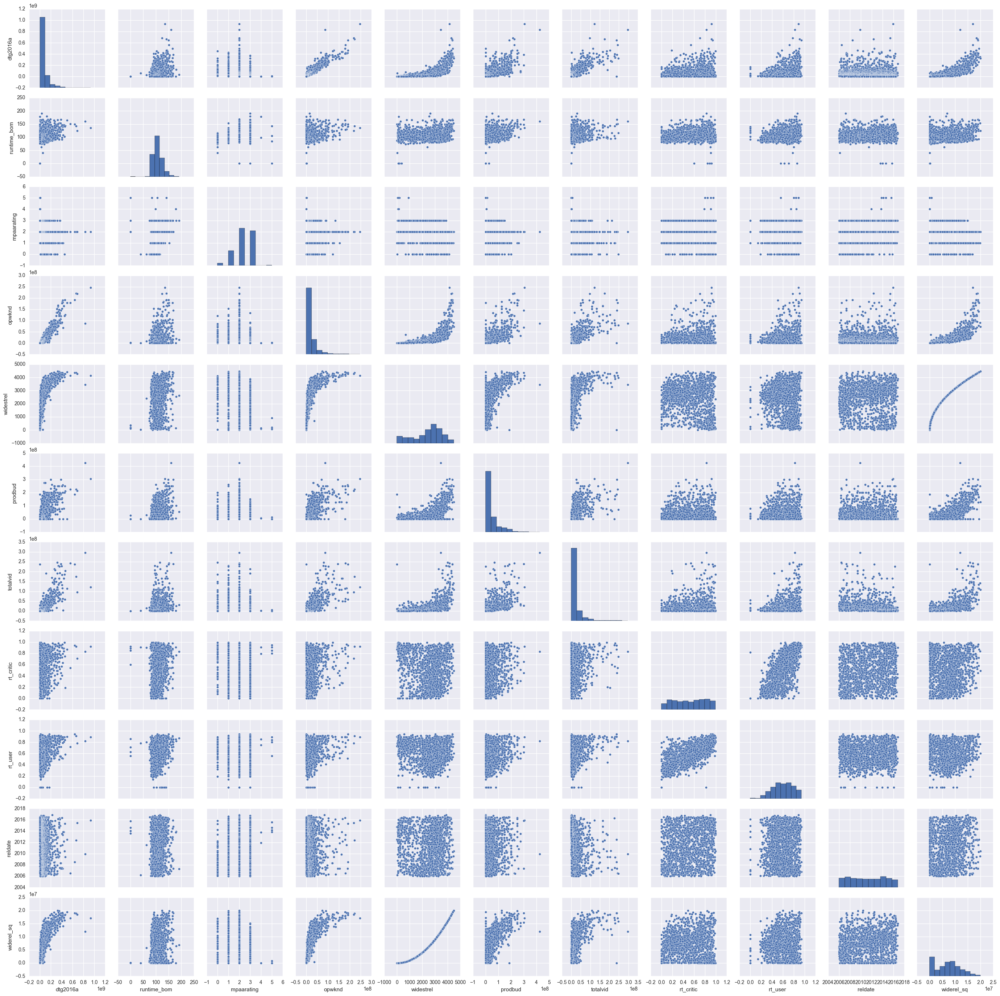

In [37]:
# Now let's try this again
sns.pairplot(df2)

In [35]:
df2.columns

Index(['dtg2016a', 'genres', 'runtime_bom', 'mpaarating', 'opwknd',
       'widestrel', 'directors', 'prodbud', 'totalvid', 'rt_critic', 'rt_user',
       'reldate', 'widerel_sq', 'widerel_4th'],
      dtype='object')

In [36]:
print(len(df2.columns))
print(len(df3.columns))

14
999


In [50]:
print(len(X_ho))
print(len(X_train))
print(len(X_test))

91
1053
452


In [108]:
df3 = pd.get_dummies(df2, prefix='is_')

In [73]:
holdout = df3[ df3['reldate'] >= 2016 ]
df4 = df3[ df3['reldate'] < 2016 ]

In [74]:
X_ho,y_ho = holdout.drop('totalvid',axis=1),holdout['totalvid']

In [75]:
X,y = df4.drop('totalvid', axis=1),df4['totalvid']

In [76]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state = 42)

In [77]:
lr_model1 = LinearRegression()
lr_model1.fit(X_train,y_train)

LinearRegression(copy_X=True, fit_intercept=True, n_jobs=1, normalize=False)

In [78]:
test_pred = lr_model1.predict(X_test)

In [79]:
## linreg
np.sqrt(np.mean((test_pred - y_test)**2))
# 21805173.932162467

21805173.932162467

In [80]:

test_pred_lr1 = lr_model1.predict(X_test)

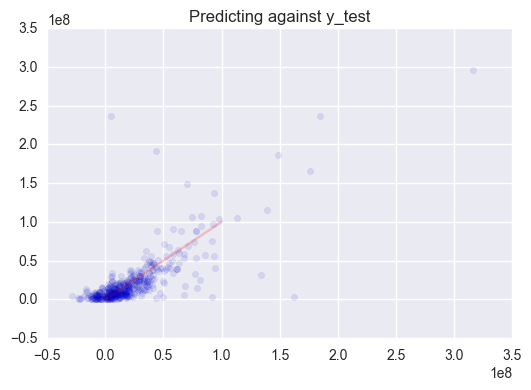

In [81]:
plt.scatter(test_pred_lr1,y_test,alpha=.1)
plt.plot(np.linspace(0,100000000,1000),np.linspace(0,100000000,1000),color='red',alpha=0.2)
plt.title('Predicting against y_test')

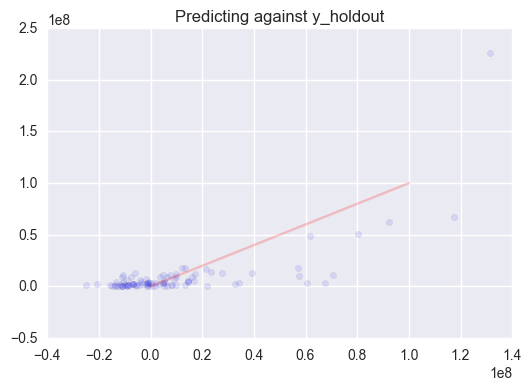

In [82]:
test_pred_lr1_ho = lr_model1.predict(X_ho)
plt.scatter(test_pred_lr1_ho,y_ho,alpha=.1)
plt.plot(np.linspace(0,100000000,1000),np.linspace(0,100000000,1000),color='red',alpha=0.2)
plt.title('Predicting against y_holdout')

In [69]:
df4.corr()

,dtg2016a,runtime_bom,mpaarating,opwknd,widestrel,prodbud,totalvid,rt_critic,rt_user,reldate,...,is__William Riead,is__Wolfgang Petersen,is__Woody Allen,is__Zach Braff,is__Zach Cregger,is__Zach Helm,is__Zack Snyder,is__Zal Batmanglij,is__Zhang Yimou,is__unlisted
dtg2016a,1.000000,0.285143,-0.202533,0.931197,0.614600,0.697193,0.820160,0.179212,0.259498,-0.011210,...,-0.019621,0.003327,-0.030180,-0.018976,-0.018499,-0.008334,0.058494,-0.019386,-0.017666,-0.059414
runtime_bom,0.285143,1.000000,0.174518,0.259496,0.104041,0.330409,0.245558,0.220474,0.298187,0.083827,...,0.016642,-0.012086,-0.043163,0.009460,-0.025014,-0.020704,0.061706,0.012333,0.009460,-0.076148
mpaarating,-0.202533,0.174518,1.000000,-0.171323,-0.280074,-0.241515,-0.220431,0.107082,-0.022277,0.075706,...,-0.036886,-0.005344,0.012684,0.026198,0.026198,-0.068428,0.002159,-0.005344,0.026198,0.053080
opwknd,0.931197,0.259496,-0.171323,1.000000,0.633811,0.681688,0.737061,0.090740,0.163038,-0.003820,...,-0.018936,0.007567,-0.040435,-0.018512,-0.016991,-0.008348,0.086038,-0.019509,-0.017845,-0.060231
widestrel,0.614600,0.104041,-0.280074,0.633811,1.000000,0.604588,0.485910,-0.199943,-0.138913,-0.011984,...,-0.035822,0.026330,-0.083835,-0.038919,-0.015889,0.017318,0.058235,-0.051913,-0.027718,-0.150254
prodbud,0.697193,0.330409,-0.241515,0.681688,0.604588,1.000000,0.597832,0.058020,0.078267,0.031168,...,-0.021809,0.057222,-0.036240,-0.018845,-0.018845,-0.021809,0.083441,-0.018598,0.000418,-0.063753
totalvid,0.820160,0.245558,-0.220431,0.737061,0.485910,0.597832,1.000000,0.166388,0.280870,-0.176804,...,-0.016867,-0.001378,-0.033233,-0.017308,-0.012722,-0.002771,0.102815,-0.017356,-0.011245,-0.052857
rt_critic,0.179212,0.220474,0.107082,0.090740,-0.199943,0.058020,0.166388,1.000000,0.725539,0.139729,...,-0.021517,-0.016968,0.035388,-0.006959,-0.042444,-0.013328,-0.002136,0.020337,0.013058,0.091344
rt_user,0.259498,0.298187,-0.022277,0.163038,-0.138913,0.078267,0.280870,0.725539,1.000000,0.043948,...,0.013977,-0.023980,0.002675,-0.001487,-0.043660,-0.007110,0.028147,0.006948,0.006948,0.073759
reldate,-0.011210,0.083827,0.075706,-0.003820,-0.011984,0.031168,-0.176804,0.139729,0.043948,1.000000,...,0.043182,-0.040633,0.035613,0.030792,-0.015853,-0.027514,-0.012976,0.020588,-0.035532,0.085414


In [83]:
df2.corr()

,dtg2016a,runtime_bom,mpaarating,opwknd,widestrel,prodbud,totalvid,rt_critic,rt_user,reldate,widerel_sq,widerel_4th,year,month,open_over_total
dtg2016a,1.000000,0.288119,-0.206646,0.931643,0.612998,0.689315,0.813047,0.183058,0.267354,-0.016488,0.710975,0.796026,-0.020400,0.042797,-0.027579
runtime_bom,0.288119,1.000000,0.165486,0.268214,0.112102,0.341731,0.241989,0.213075,0.294794,0.072542,0.143434,0.184535,0.058270,0.151336,-0.102049
mpaarating,-0.206646,0.165486,1.000000,-0.173360,-0.282150,-0.243488,-0.224949,0.109319,-0.023837,0.082730,-0.307818,-0.319450,0.078764,0.039802,0.013354
opwknd,0.931643,0.268214,-0.173360,1.000000,0.631070,0.678924,0.724186,0.096296,0.173548,0.000608,0.731052,0.820980,0.004336,-0.040244,0.151372
widestrel,0.612998,0.112102,-0.282150,0.631070,1.000000,0.602511,0.472785,-0.198073,-0.132604,0.006853,0.965622,0.836384,0.012636,-0.062629,0.387746
prodbud,0.689315,0.341731,-0.243488,0.678924,0.602511,1.000000,0.574562,0.051924,0.081285,0.027336,0.690091,0.750295,0.023020,0.045578,0.065748
totalvid,0.813047,0.241989,-0.224949,0.724186,0.472785,0.574562,1.000000,0.166855,0.281791,-0.194664,0.558798,0.639883,-0.197819,0.041046,-0.057874
rt_critic,0.183058,0.213075,0.109319,0.096296,-0.198073,0.051924,0.166855,1.000000,0.716411,0.125332,-0.112580,0.002024,0.108515,0.176895,-0.517466
rt_user,0.267354,0.294794,-0.023837,0.173548,-0.132604,0.081285,0.281791,0.716411,1.000000,0.029735,-0.056306,0.050779,0.016333,0.143497,-0.472886
reldate,-0.016488,0.072542,0.082730,0.000608,0.006853,0.027336,-0.194664,0.125332,0.029735,1.000000,0.053493,0.089067,0.995694,0.010417,-0.050122


In [84]:
selected_columns_1 = ['opwknd','widerel_4th','prodbud','dtg2016a']

In [85]:
lr_model2 = LinearRegression()
lr_model2.fit(X_train.loc[:,selected_columns_1],y_train)

LinearRegression(copy_X=True, fit_intercept=True, n_jobs=1, normalize=False)

In [86]:
#train_set_pred1 = lr_model1.predict(X_train.loc[:,selected_columns_1])
test_pred_lr2 = lr_model2.predict(X_test.loc[:,selected_columns_1])

In [87]:
## linreg, just ['opwknd','widerel_sq','prodbud','dtg2016a']
np.sqrt(np.mean((test_pred_lr2 - y_test)**2))
# 21805173.932162467 # best before this lr1
# 19367885.600209653 # this

19367885.600209653

In [88]:
list(zip(X_train.loc[:,selected_columns_1].columns,lr_model2.coef_))

[('opwknd', -0.45439270683853694),
 ('widerel_4th', 3.8196912818306301e-08),
 ('prodbud', 0.0036655813663601933),
 ('dtg2016a', 0.41513471499302151)]

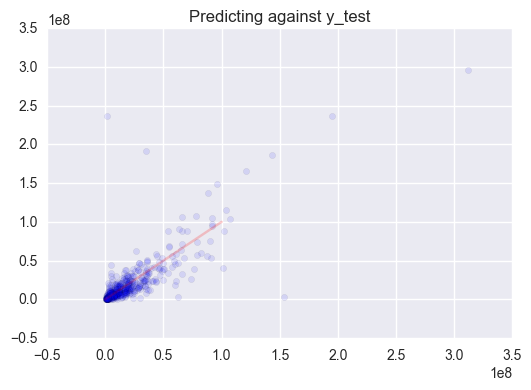

In [89]:
plt.scatter(test_pred_lr2,y_test,alpha=.1)
plt.plot(np.linspace(0,100000000,1000),np.linspace(0,100000000,1000),color='red',alpha=0.2)
plt.title('Predicting against y_test')

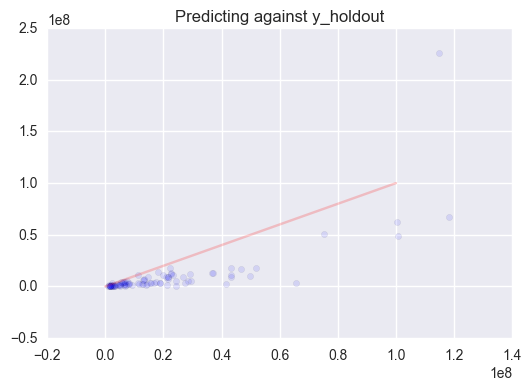

In [90]:
test_pred_lr2_ho = lr_model2.predict(X_ho.loc[:,selected_columns_1])
plt.scatter(test_pred_lr2_ho,y_ho,alpha=.1)
plt.plot(np.linspace(0,100000000,1000),np.linspace(0,100000000,1000),color='red',alpha=0.2)
plt.title('Predicting against y_holdout')

In [109]:
# BOOKMARK
import math
# Putting 'totalvid' on a log scale
df3['totalvidlog10'] = df3['totalvid'].apply(math.log10)

In [110]:
df3.drop(['totalvid'],axis=1,inplace=True)

In [111]:
holdout = df3[ df3['reldate'] >= 2016 ]
df4 = df3[ df3['reldate'] < 2016 ]

In [112]:
X_ho,y_ho = holdout.drop('totalvidlog10',axis=1),holdout['totalvidlog10']

In [113]:
X,y = df4.drop('totalvidlog10', axis=1),df4['totalvidlog10']

In [114]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state = 42)

In [115]:
lr_model1 = LinearRegression()
lr_model1.fit(X_train,y_train)

LinearRegression(copy_X=True, fit_intercept=True, n_jobs=1, normalize=False)

In [158]:
## linreg
test_pred = lr_model1.predict(X_test)
#math.pow(10,np.sqrt(np.mean((test_pred - y_test)**2)))
math.pow(10,np.sqrt(np.mean((test_pred - y_test)**2)))
# 2.37805854613997

2.37805854613997

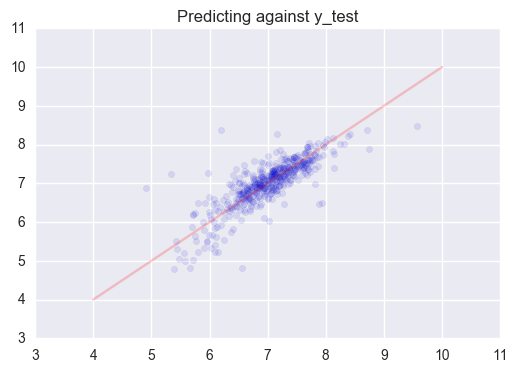

In [119]:
test_pred_lr1 = lr_model1.predict(X_test)
plt.scatter(test_pred_lr1,y_test,alpha=.1)
plt.plot(np.linspace(4,10,1000),np.linspace(4,10,1000),color='red',alpha=0.2)
plt.title('Predicting against y_test')

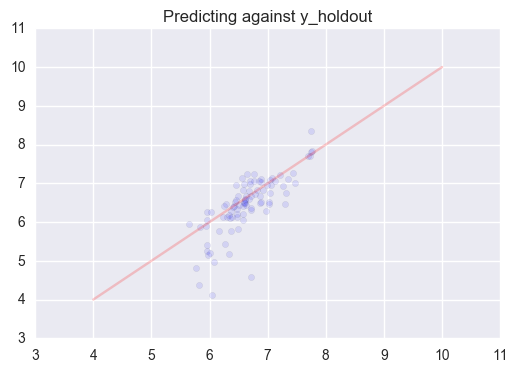

In [120]:
test_pred_lr1_ho = lr_model1.predict(X_ho)
plt.scatter(test_pred_lr1_ho,y_ho,alpha=.1)
plt.plot(np.linspace(4,10,1000),np.linspace(4,10,1000),color='red',alpha=0.2)
plt.title('Predicting against y_holdout')

In [121]:
print(np.mean(y_ho))
print(np.mean(y_test))
print(np.mean(y_train))

6.44913333340733
6.993190145379907
7.009907235757746


In [131]:
df2.columns

Index(['dtg2016a', 'genres', 'runtime_bom', 'mpaarating', 'opwknd',
       'widestrel', 'directors', 'prodbud', 'totalvid', 'rt_critic', 'rt_user',
       'reldate', 'widerel_sq', 'widerel_4th', 'year', 'month',
       'open_over_total'],
      dtype='object')

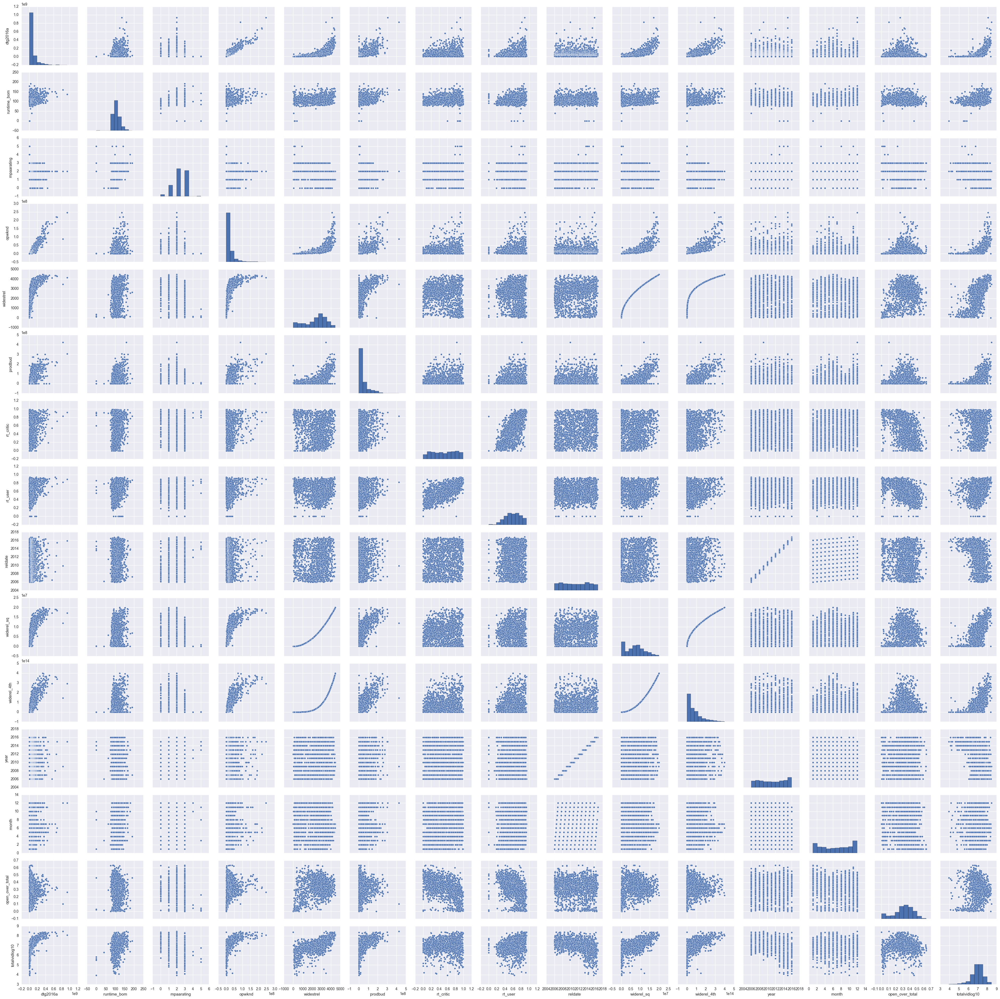

In [134]:
sns.pairplot(df3[['dtg2016a', 'runtime_bom', 'mpaarating', 'opwknd',
       'widestrel', 'prodbud', 'rt_critic', 'rt_user',
       'reldate', 'widerel_sq', 'widerel_4th', 'year', 'month',
       'open_over_total', 'totalvidlog10']])

In [142]:
df3['widerel_sqrt'] = df3['widestrel'].apply(math.sqrt)
df3['widerel_4trt'] = df3['widestrel'].apply(lambda x: x**(1/4))

In [143]:
df3[['dtg2016a', 'runtime_bom', 'mpaarating', 'opwknd',
       'widestrel', 'prodbud', 'rt_critic', 'rt_user',
       'reldate', 'widerel_sq', 'widerel_4th', 'widerel_sqrt', 'widerel_4trt', 'year', 'month',
       'open_over_total', 'totalvidlog10']].corr()

,dtg2016a,runtime_bom,mpaarating,opwknd,widestrel,prodbud,rt_critic,rt_user,reldate,widerel_sq,widerel_4th,widerel_sqrt,widerel_4trt,year,month,open_over_total,totalvidlog10
dtg2016a,1.000000,0.288119,-0.206646,0.931643,0.612998,0.689315,0.183058,0.267354,-0.016488,0.710975,0.796026,0.538581,0.491153,-0.020400,0.042797,-0.027579,0.616999
runtime_bom,0.288119,1.000000,0.165486,0.268214,0.112102,0.341731,0.213075,0.294794,0.072542,0.143434,0.184535,0.093065,0.080338,0.058270,0.151336,-0.102049,0.234690
mpaarating,-0.206646,0.165486,1.000000,-0.173360,-0.282150,-0.243488,0.109319,-0.023837,0.082730,-0.307818,-0.319450,-0.259447,-0.242605,0.078764,0.039802,0.013354,-0.245124
opwknd,0.931643,0.268214,-0.173360,1.000000,0.631070,0.678924,0.096296,0.173548,0.000608,0.731052,0.820980,0.555209,0.506692,0.004336,-0.040244,0.151372,0.576950
widestrel,0.612998,0.112102,-0.282150,0.631070,1.000000,0.602511,-0.198073,-0.132604,0.006853,0.965622,0.836384,0.982668,0.953150,0.012636,-0.062629,0.387746,0.656568
prodbud,0.689315,0.341731,-0.243488,0.678924,0.602511,1.000000,0.051924,0.081285,0.027336,0.690091,0.750295,0.529947,0.479033,0.023020,0.045578,0.065748,0.535054
rt_critic,0.183058,0.213075,0.109319,0.096296,-0.198073,0.051924,1.000000,0.716411,0.125332,-0.112580,0.002024,-0.243817,-0.263764,0.108515,0.176895,-0.517466,0.012933
rt_user,0.267354,0.294794,-0.023837,0.173548,-0.132604,0.081285,0.716411,1.000000,0.029735,-0.056306,0.050779,-0.170255,-0.186230,0.016333,0.143497,-0.472886,0.175408
reldate,-0.016488,0.072542,0.082730,0.000608,0.006853,0.027336,0.125332,0.029735,1.000000,0.053493,0.089067,-0.025861,-0.043083,0.995694,0.010417,-0.050122,-0.415311
widerel_sq,0.710975,0.143434,-0.307818,0.731052,0.965622,0.690091,-0.112580,-0.056306,0.053493,1.000000,0.944312,0.904703,0.852966,0.058010,-0.050654,0.273705,0.646958


In [144]:
selected_columns_1 = ['opwknd','widestrel','prodbud','dtg2016a']

In [145]:
lr_model2 = LinearRegression()
lr_model2.fit(X_train.loc[:,selected_columns_1],y_train)

LinearRegression(copy_X=True, fit_intercept=True, n_jobs=1, normalize=False)

In [146]:
#train_set_pred1 = lr_model1.predict(X_train.loc[:,selected_columns_1])
test_pred_lr2 = lr_model2.predict(X_test.loc[:,selected_columns_1])

In [157]:
## linreg, just ['opwknd','widerel_sq','prodbud','dtg2016a']
math.pow(10,np.sqrt(np.mean((test_pred_lr2 - y_test)**2)))
# 2.37805854613997 # best before this lr1
# 2.711984706908455 # this

2.711984706908455

In [148]:
list(zip(X_train.loc[:,selected_columns_1].columns,lr_model2.coef_))

[('opwknd', -7.5935291101824234e-09),
 ('widestrel', 0.00025979860360451017),
 ('prodbud', 6.9231852969545537e-10),
 ('dtg2016a', 4.5328988633476163e-09)]

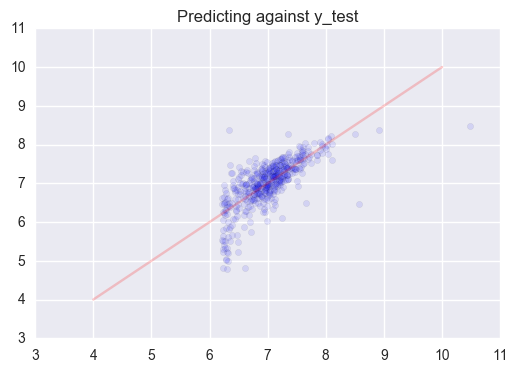

In [149]:
plt.scatter(test_pred_lr2,y_test,alpha=.1)
plt.plot(np.linspace(4,10,1000),np.linspace(4,10,1000),color='red',alpha=0.2)
plt.title('Predicting against y_test')

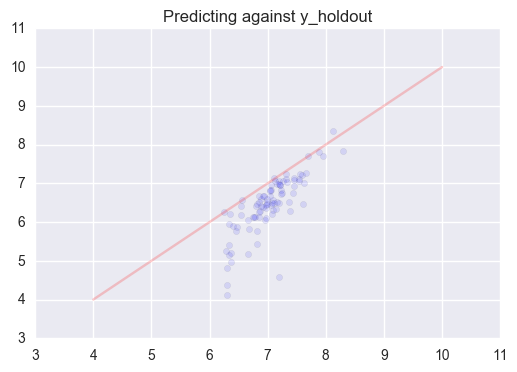

In [150]:
test_pred_lr2_ho = lr_model2.predict(X_ho.loc[:,selected_columns_1])
plt.scatter(test_pred_lr2_ho,y_ho,alpha=.1)
plt.plot(np.linspace(4,10,1000),np.linspace(4,10,1000),color='red',alpha=0.2)
plt.title('Predicting against y_holdout')

In [151]:
rfmodel1 = RandomForestRegressor()
rfmodel1.fit(X_train,y_train)

RandomForestRegressor(bootstrap=True, criterion='mse', max_depth=None,
           max_features='auto', max_leaf_nodes=None,
           min_impurity_split=1e-07, min_samples_leaf=1,
           min_samples_split=2, min_weight_fraction_leaf=0.0,
           n_estimators=10, n_jobs=1, oob_score=False, random_state=None,
           verbose=0, warm_start=False)

In [152]:
# Use the trained model to predict the results on the test set

test_pred_rf1 = rfmodel1.predict(X_test)

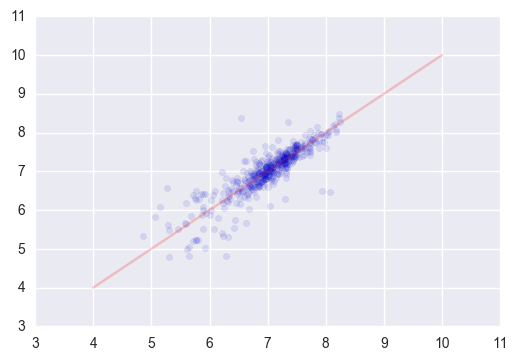

In [154]:
plt.scatter(test_pred_rf1,y_test,alpha=.1)
plt.plot(np.linspace(4,10,1000),np.linspace(4,10,1000),color='red',alpha=0.2)

In [155]:
## randomforest, (n_estimators = 500, min_samples_leaf=5, max_features=4, n_jobs=-1)
math.pow(10,np.sqrt(np.mean((test_pred_rf1 - y_test)**2)))
# 2.0578865948310376 # this
# 2.37805854613997 # best before this lr1

2.0578865948310376

In [159]:
rfmodel2 = RandomForestRegressor(n_estimators = 1000, min_samples_leaf=5, n_jobs=-1)
rfmodel2.fit(X_train,y_train)

RandomForestRegressor(bootstrap=True, criterion='mse', max_depth=None,
           max_features='auto', max_leaf_nodes=None,
           min_impurity_split=1e-07, min_samples_leaf=5,
           min_samples_split=2, min_weight_fraction_leaf=0.0,
           n_estimators=1000, n_jobs=-1, oob_score=False,
           random_state=None, verbose=0, warm_start=False)

In [160]:
# Use the trained model to predict the results on the test set

test_pred_rf2 = rfmodel2.predict(X_test)

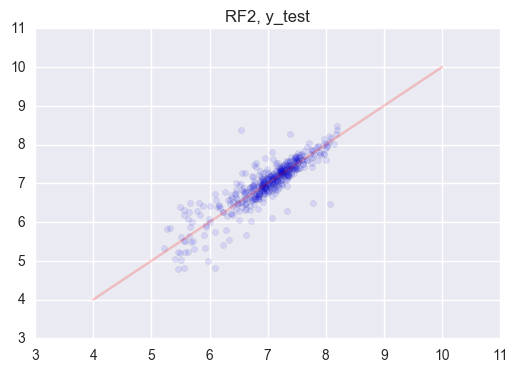

In [167]:
plt.scatter(test_pred_rf2,y_test,alpha=.1)
plt.plot(np.linspace(4,10,1000),np.linspace(4,10,1000),color='red',alpha=0.2)
plt.title('RF2, y_test')

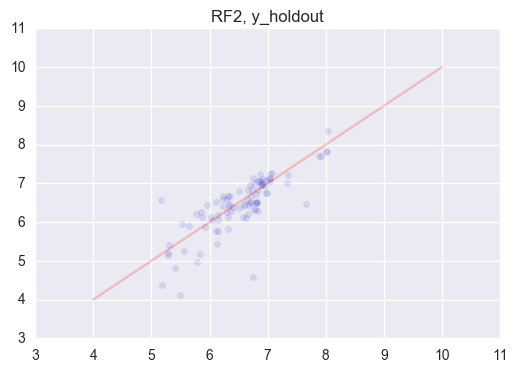

In [169]:
test_pred_rf2_ho = rfmodel2.predict(X_ho)
plt.scatter(test_pred_rf2_ho,y_ho,alpha=.1)
plt.plot(np.linspace(4,10,1000),np.linspace(4,10,1000),color='red',alpha=0.2)
plt.title('RF2, y_holdout')

In [163]:
## randomforest, (n_estimators = 1000, min_samples_leaf=5, n_jobs=-1)
math.pow(10,np.sqrt(np.mean((test_pred_rf2 - y_test)**2)))
# 1.9821908499703274 # this
# 2.0578865948310376 # best before this rf1

1.9821908499703274

In [34]:
ne_range = [1000]
#mss_range = list(range(2, 11))
mss_range = [2,3,4]
#msl_range = list(range(1, 11))
msl_range = [5]
mf_range = [5,10,15,20,'auto']

In [97]:
param_grid = dict(n_estimators=ne_range, min_samples_split=mss_range, min_samples_leaf=msl_range, 
                  max_features=mf_range)
rfr = RandomForestRegressor()
print(param_grid)

{'max_features': [5, 10, 15, 20, 'auto'], 'min_samples_split': [2, 3, 4], 'n_estimators': [1000], 'min_samples_leaf': [5]}


In [98]:
#grid = GridSearchCV(RandomForestRegressor, param_grid, cv=10, scoring='accuracy')
grid = GridSearchCV(rfr, param_grid, cv=10)
# fit the grid with data
grid.fit(X_test, y_test)

GridSearchCV(cv=10, error_score='raise',
       estimator=RandomForestRegressor(bootstrap=True, criterion='mse', max_depth=None,
           max_features='auto', max_leaf_nodes=None,
           min_impurity_split=1e-07, min_samples_leaf=1,
           min_samples_split=2, min_weight_fraction_leaf=0.0,
           n_estimators=10, n_jobs=1, oob_score=False, random_state=None,
           verbose=0, warm_start=False),
       fit_params={}, iid=True, n_jobs=1,
       param_grid={'max_features': [5, 10, 15, 20, 'auto'], 'min_samples_split': [2, 3, 4], 'n_estimators': [1000], 'min_samples_leaf': [5]},
       pre_dispatch='2*n_jobs', refit=True, scoring=None, verbose=0)

In [99]:
grid.grid_scores_

[mean: -0.06866, std: 0.14460, params: {'max_features': 5, 'min_samples_split': 2, 'n_estimators': 1000, 'min_samples_leaf': 5},
 mean: -0.06967, std: 0.14724, params: {'max_features': 5, 'min_samples_split': 3, 'n_estimators': 1000, 'min_samples_leaf': 5},
 mean: -0.06834, std: 0.14472, params: {'max_features': 5, 'min_samples_split': 4, 'n_estimators': 1000, 'min_samples_leaf': 5},
 mean: -0.04236, std: 0.13924, params: {'max_features': 10, 'min_samples_split': 2, 'n_estimators': 1000, 'min_samples_leaf': 5},
 mean: -0.03849, std: 0.13789, params: {'max_features': 10, 'min_samples_split': 3, 'n_estimators': 1000, 'min_samples_leaf': 5},
 mean: -0.03461, std: 0.13388, params: {'max_features': 10, 'min_samples_split': 4, 'n_estimators': 1000, 'min_samples_leaf': 5},
 mean: -0.00387, std: 0.14077, params: {'max_features': 15, 'min_samples_split': 2, 'n_estimators': 1000, 'min_samples_leaf': 5},
 mean: -0.00495, std: 0.12890, params: {'max_features': 15, 'min_samples_split': 3, 'n_estima

In [100]:
print(grid.best_score_)
print(grid.best_params_)
print(grid.best_estimator_)

0.42507257919356445
{'max_features': 'auto', 'min_samples_split': 4, 'n_estimators': 1000, 'min_samples_leaf': 5}
RandomForestRegressor(bootstrap=True, criterion='mse', max_depth=None,
           max_features='auto', max_leaf_nodes=None,
           min_impurity_split=1e-07, min_samples_leaf=5,
           min_samples_split=4, min_weight_fraction_leaf=0.0,
           n_estimators=1000, n_jobs=1, oob_score=False, random_state=None,
           verbose=0, warm_start=False)


In [101]:
ne_range = [1000]
#mss_range = list(range(4, 8))
mss_range = [2,3,4]
#msl_range = list(range(1, 11))
msl_range = [3,4,5,6,7]
mf_range = ['auto']

In [105]:
param_grid = dict(n_estimators=ne_range, min_samples_split=mss_range, min_samples_leaf=msl_range, 
                  max_features=mf_range)
rfr = RandomForestRegressor()
print(param_grid)

{'max_features': ['auto'], 'min_samples_split': [2, 3, 4], 'n_estimators': [1000], 'min_samples_leaf': [3, 4, 5, 6, 7]}


In [107]:
#grid = GridSearchCV(RandomForestRegressor, param_grid, cv=10, scoring='accuracy')
grid = GridSearchCV(rfr, param_grid, cv=10)
# fit the grid with data
grid.fit(X_test, y_test)


GridSearchCV(cv=10, error_score='raise',
       estimator=RandomForestRegressor(bootstrap=True, criterion='mse', max_depth=None,
           max_features='auto', max_leaf_nodes=None,
           min_impurity_split=1e-07, min_samples_leaf=1,
           min_samples_split=2, min_weight_fraction_leaf=0.0,
           n_estimators=10, n_jobs=1, oob_score=False, random_state=None,
           verbose=0, warm_start=False),
       fit_params={}, iid=True, n_jobs=1,
       param_grid={'max_features': ['auto'], 'min_samples_split': [2, 3, 4], 'n_estimators': [1000], 'min_samples_leaf': [3, 4, 5, 6, 7]},
       pre_dispatch='2*n_jobs', refit=True, scoring=None, verbose=0)

In [108]:
grid.grid_scores_

[mean: 0.43956, std: 0.70259, params: {'max_features': 'auto', 'min_samples_split': 2, 'n_estimators': 1000, 'min_samples_leaf': 3},
 mean: 0.44947, std: 0.68341, params: {'max_features': 'auto', 'min_samples_split': 3, 'n_estimators': 1000, 'min_samples_leaf': 3},
 mean: 0.44124, std: 0.70085, params: {'max_features': 'auto', 'min_samples_split': 4, 'n_estimators': 1000, 'min_samples_leaf': 3},
 mean: 0.41434, std: 0.75572, params: {'max_features': 'auto', 'min_samples_split': 2, 'n_estimators': 1000, 'min_samples_leaf': 4},
 mean: 0.40758, std: 0.77507, params: {'max_features': 'auto', 'min_samples_split': 3, 'n_estimators': 1000, 'min_samples_leaf': 4},
 mean: 0.42341, std: 0.73842, params: {'max_features': 'auto', 'min_samples_split': 4, 'n_estimators': 1000, 'min_samples_leaf': 4},
 mean: 0.42442, std: 0.71192, params: {'max_features': 'auto', 'min_samples_split': 2, 'n_estimators': 1000, 'min_samples_leaf': 5},
 mean: 0.42558, std: 0.69614, params: {'max_features': 'auto', 'min_s

In [111]:
print(grid.best_score_)
print(grid.best_params_)
print(grid.best_estimator_)

0.4652402907604525
{'max_features': 'auto', 'min_samples_split': 2, 'n_estimators': 1000, 'min_samples_leaf': 7}
RandomForestRegressor(bootstrap=True, criterion='mse', max_depth=None,
           max_features='auto', max_leaf_nodes=None,
           min_impurity_split=1e-07, min_samples_leaf=7,
           min_samples_split=2, min_weight_fraction_leaf=0.0,
           n_estimators=1000, n_jobs=1, oob_score=False, random_state=None,
           verbose=0, warm_start=False)


In [112]:
ne_range = [1000]
#mss_range = list(range(4, 8))
mss_range = [2,4]
#msl_range = list(range(1, 11))
msl_range = [3,7,8,9,10]
mf_range = ['auto']

param_grid = dict(n_estimators=ne_range, min_samples_split=mss_range, min_samples_leaf=msl_range, 
                  max_features=mf_range)
rfr = RandomForestRegressor()
print(param_grid)



{'max_features': ['auto'], 'min_samples_split': [2, 4], 'n_estimators': [1000], 'min_samples_leaf': [3, 7, 8, 9, 10]}


In [113]:
#grid = GridSearchCV(RandomForestRegressor, param_grid, cv=10, scoring='accuracy')
grid = GridSearchCV(rfr, param_grid, cv=10)
# fit the grid with data
grid.fit(X_test, y_test)



0

In [114]:
grid.grid_scores_

[mean: 0.44360, std: 0.69149, params: {'max_features': 'auto', 'min_samples_split': 2, 'n_estimators': 1000, 'min_samples_leaf': 3},
 mean: 0.44142, std: 0.70010, params: {'max_features': 'auto', 'min_samples_split': 4, 'n_estimators': 1000, 'min_samples_leaf': 3},
 mean: 0.45652, std: 0.58357, params: {'max_features': 'auto', 'min_samples_split': 2, 'n_estimators': 1000, 'min_samples_leaf': 7},
 mean: 0.46290, std: 0.56335, params: {'max_features': 'auto', 'min_samples_split': 4, 'n_estimators': 1000, 'min_samples_leaf': 7},
 mean: 0.47095, std: 0.53009, params: {'max_features': 'auto', 'min_samples_split': 2, 'n_estimators': 1000, 'min_samples_leaf': 8},
 mean: 0.47154, std: 0.53204, params: {'max_features': 'auto', 'min_samples_split': 4, 'n_estimators': 1000, 'min_samples_leaf': 8},
 mean: 0.48102, std: 0.49475, params: {'max_features': 'auto', 'min_samples_split': 2, 'n_estimators': 1000, 'min_samples_leaf': 9},
 mean: 0.47827, std: 0.50550, params: {'max_features': 'auto', 'min_s

In [115]:
print(grid.best_score_)
print(grid.best_params_)
print(grid.best_estimator_)

0.4810164777002787
{'max_features': 'auto', 'min_samples_split': 2, 'n_estimators': 1000, 'min_samples_leaf': 9}
RandomForestRegressor(bootstrap=True, criterion='mse', max_depth=None,
           max_features='auto', max_leaf_nodes=None,
           min_impurity_split=1e-07, min_samples_leaf=9,
           min_samples_split=2, min_weight_fraction_leaf=0.0,
           n_estimators=1000, n_jobs=1, oob_score=False, random_state=None,
           verbose=0, warm_start=False)


In [117]:
ne_range = [500,1000,1500,2000,3000]
#mss_range = list(range(4, 8))
mss_range = [2]
#msl_range = list(range(1, 11))
msl_range = [9]
mf_range = ['auto']

param_grid = dict(n_estimators=ne_range, min_samples_split=mss_range, min_samples_leaf=msl_range, 
                  max_features=mf_range)
rfr = RandomForestRegressor()
print(param_grid)


{'max_features': ['auto'], 'min_samples_split': [2], 'n_estimators': [500, 1000, 1500, 2000, 3000], 'min_samples_leaf': [9]}


In [118]:
#grid = GridSearchCV(RandomForestRegressor, param_grid, cv=10, scoring='accuracy')
grid = GridSearchCV(rfr, param_grid, cv=10)
# fit the grid with data
grid.fit(X_test, y_test)



GridSearchCV(cv=10, error_score='raise',
       estimator=RandomForestRegressor(bootstrap=True, criterion='mse', max_depth=None,
           max_features='auto', max_leaf_nodes=None,
           min_impurity_split=1e-07, min_samples_leaf=1,
           min_samples_split=2, min_weight_fraction_leaf=0.0,
           n_estimators=10, n_jobs=1, oob_score=False, random_state=None,
           verbose=0, warm_start=False),
       fit_params={}, iid=True, n_jobs=1,
       param_grid={'max_features': ['auto'], 'min_samples_split': [2], 'n_estimators': [500, 1000, 1500, 2000, 3000], 'min_samples_leaf': [9]},
       pre_dispatch='2*n_jobs', refit=True, scoring=None, verbose=0)

In [119]:
grid.grid_scores_

[mean: 0.47124, std: 0.52067, params: {'max_features': 'auto', 'min_samples_split': 2, 'n_estimators': 500, 'min_samples_leaf': 9},
 mean: 0.47724, std: 0.50079, params: {'max_features': 'auto', 'min_samples_split': 2, 'n_estimators': 1000, 'min_samples_leaf': 9},
 mean: 0.47424, std: 0.50882, params: {'max_features': 'auto', 'min_samples_split': 2, 'n_estimators': 1500, 'min_samples_leaf': 9},
 mean: 0.47687, std: 0.50675, params: {'max_features': 'auto', 'min_samples_split': 2, 'n_estimators': 2000, 'min_samples_leaf': 9},
 mean: 0.47730, std: 0.50150, params: {'max_features': 'auto', 'min_samples_split': 2, 'n_estimators': 3000, 'min_samples_leaf': 9}]

In [120]:
print(grid.best_score_)
print(grid.best_params_)
print(grid.best_estimator_)

0.4773039194418539
{'max_features': 'auto', 'min_samples_split': 2, 'n_estimators': 3000, 'min_samples_leaf': 9}
RandomForestRegressor(bootstrap=True, criterion='mse', max_depth=None,
           max_features='auto', max_leaf_nodes=None,
           min_impurity_split=1e-07, min_samples_leaf=9,
           min_samples_split=2, min_weight_fraction_leaf=0.0,
           n_estimators=3000, n_jobs=1, oob_score=False, random_state=None,
           verbose=0, warm_start=False)


In [164]:
rfmodel3 = RandomForestRegressor(n_estimators = 3000, min_samples_leaf=9, min_samples_split=2, n_jobs=-1)
#rfmodel3 = RandomForestRegressor(n_estimators = 1000, min_samples_leaf=5, min_samples_split=2, n_jobs=-1)
rfmodel3.fit(X_train,y_train)

'''
(n_estimators=10, criterion='mse', max_depth=None, min_samples_split=2, min_samples_leaf=1, 
min_weight_fraction_leaf=0.0, max_features='auto', max_leaf_nodes=None, min_impurity_split=1e-07, 
bootstrap=True, oob_score=False, n_jobs=1, random_state=None, verbose=0, warm_start=False)
'''

"\n(n_estimators=10, criterion='mse', max_depth=None, min_samples_split=2, min_samples_leaf=1, \nmin_weight_fraction_leaf=0.0, max_features='auto', max_leaf_nodes=None, min_impurity_split=1e-07, \nbootstrap=True, oob_score=False, n_jobs=1, random_state=None, verbose=0, warm_start=False)\n"

In [165]:
# Use the trained model to predict the results on the test set

test_pred_rf3 = rfmodel3.predict(X_test)

In [166]:
## randomforest, (n_estimators = 3000, min_samples_leaf=9, min_samples_split=2, n_jobs=-1)
math.pow(10,np.sqrt(np.mean((test_pred_rf3 - y_test)**2)))
# 1.9821908499703274 # best before this rf2
# 1.9886701490471084 # this

1.9886701490471084

In [170]:
gbmodel0 = GradientBoostingRegressor()
# subsample = sampling just much of the data without replacement
'''

(loss='ls', learning_rate=0.1, n_estimators=100, subsample=1.0, criterion='friedman_mse', 
min_samples_split=2, min_samples_leaf=1, min_weight_fraction_leaf=0.0, max_depth=3, min_impurity_split=1e-07, 
init=None, random_state=None, max_features=None, alpha=0.9, verbose=0, max_leaf_nodes=None, warm_start=False, 
presort='auto')


'''

gbmodel0.fit(X_train, y_train)

GradientBoostingRegressor(alpha=0.9, criterion='friedman_mse', init=None,
             learning_rate=0.1, loss='ls', max_depth=3, max_features=None,
             max_leaf_nodes=None, min_impurity_split=1e-07,
             min_samples_leaf=1, min_samples_split=2,
             min_weight_fraction_leaf=0.0, n_estimators=100,
             presort='auto', random_state=None, subsample=1.0, verbose=0,
             warm_start=False)

In [173]:
test_pred_gb0 = gbmodel0.predict(X_test)
math.pow(10,np.sqrt(np.mean((test_pred_gb0 - y_test)**2)))
# 1.9821908499703274 # best before this rf2
# 1.9920616459320715 # this

1.9920616459320715

In [38]:
gbmodel1 = GradientBoostingRegressor(subsample = 0.8, n_estimators = 3000, random_state = 1000, 
                                     learning_rate = 0.1, max_features = 5, min_samples_leaf = 9)
# subsample = sampling just much of the data without replacement
'''

(loss='ls', learning_rate=0.1, n_estimators=100, subsample=1.0, criterion='friedman_mse', 
min_samples_split=2, min_samples_leaf=1, min_weight_fraction_leaf=0.0, max_depth=3, min_impurity_split=1e-07, 
init=None, random_state=None, max_features=None, alpha=0.9, verbose=0, max_leaf_nodes=None, warm_start=False, 
presort='auto')


'''

gbmodel1.fit(X_train, y_train)

GradientBoostingRegressor(alpha=0.9, criterion='friedman_mse', init=None,
             learning_rate=0.1, loss='ls', max_depth=3, max_features=5,
             max_leaf_nodes=None, min_impurity_split=1e-07,
             min_samples_leaf=9, min_samples_split=2,
             min_weight_fraction_leaf=0.0, n_estimators=3000,
             presort='auto', random_state=1000, subsample=0.8, verbose=0,
             warm_start=False)

In [39]:
# Use the trained model to predict the results on the test set

test_pred_gb1 = gbmodel1.predict(X_test)

In [40]:
## gradientboosting, learning_rate = 0.1, max_features = 5, min_samples_leaf = 9
np.sqrt(np.mean((test_pred_gb1 - y_test)**2))
# 19965319.833026133 # this
# 19282733.399299566 # best before this, rf2

19965319.833026133

In [174]:
gbmodel2 = GradientBoostingRegressor(subsample = 0.8, n_estimators = 3000, random_state = 1000, 
                                     learning_rate = 0.1, min_samples_leaf = 9)
# subsample = sampling just much of the data without replacement
'''

(loss='ls', learning_rate=0.1, n_estimators=100, subsample=1.0, criterion='friedman_mse', 
min_samples_split=2, min_samples_leaf=1, min_weight_fraction_leaf=0.0, max_depth=3, min_impurity_split=1e-07, 
init=None, random_state=None, max_features=None, alpha=0.9, verbose=0, max_leaf_nodes=None, warm_start=False, 
presort='auto')


'''

gbmodel2.fit(X_train, y_train)

GradientBoostingRegressor(alpha=0.9, criterion='friedman_mse', init=None,
             learning_rate=0.1, loss='ls', max_depth=3, max_features=None,
             max_leaf_nodes=None, min_impurity_split=1e-07,
             min_samples_leaf=9, min_samples_split=2,
             min_weight_fraction_leaf=0.0, n_estimators=3000,
             presort='auto', random_state=1000, subsample=0.8, verbose=0,
             warm_start=False)

In [175]:
# Use the trained model to predict the results on the test set

test_pred_gb2 = gbmodel2.predict(X_test)

In [176]:
## gradientboosting, subsample = 0.8, n_estimators = 3000, learning_rate = 0.1, min_samples_leaf = 9
math.pow(10,np.sqrt(np.mean((test_pred_gb2 - y_test)**2)))
# 2.0867127215079733 # this
# 1.9821908499703274 # best before this rf2

2.0867127215079733

In [177]:
gbmodel3 = GradientBoostingRegressor(subsample = 0.8, n_estimators = 3000, random_state = 1000, 
                                     learning_rate = 0.05, min_samples_leaf = 9)
# subsample = sampling just much of the data without replacement
'''

(loss='ls', learning_rate=0.1, n_estimators=100, subsample=1.0, criterion='friedman_mse', 
min_samples_split=2, min_samples_leaf=1, min_weight_fraction_leaf=0.0, max_depth=3, min_impurity_split=1e-07, 
init=None, random_state=None, max_features=None, alpha=0.9, verbose=0, max_leaf_nodes=None, warm_start=False, 
presort='auto')


'''

gbmodel3.fit(X_train, y_train)

GradientBoostingRegressor(alpha=0.9, criterion='friedman_mse', init=None,
             learning_rate=0.05, loss='ls', max_depth=3, max_features=None,
             max_leaf_nodes=None, min_impurity_split=1e-07,
             min_samples_leaf=9, min_samples_split=2,
             min_weight_fraction_leaf=0.0, n_estimators=3000,
             presort='auto', random_state=1000, subsample=0.8, verbose=0,
             warm_start=False)

In [178]:
# Use the trained model to predict the results on the test set

test_pred_gb3 = gbmodel3.predict(X_test)

In [179]:
## gradientboosting: n_estimators = 3000, subsample = 0.8, learning_rate = 0.05, min_samples_leaf=9
math.pow(10,np.sqrt(np.mean((test_pred_gb3 - y_test)**2)))
# 2.0867127215079733 # this
# 1.9821908499703274 # best before this rf2

2.085579980547809

In [183]:
# This and the next three cells were repeated changing the different hyper parameters to optimize

ne_range = [3000]
#mss_range = list(range(4, 8))
mss_range = [2]
msl_range = [16]
mf_range = ['auto']
ss_range = [0.9]
lr_range = [0.005,0.001]

param_grid = dict(n_estimators=ne_range, min_samples_split=mss_range, min_samples_leaf=msl_range, 
                  max_features=mf_range, subsample=ss_range, learning_rate=lr_range)
gbr = GradientBoostingRegressor()
print(param_grid)


{'min_samples_split': [2], 'learning_rate': [0.005, 0.001], 'min_samples_leaf': [16], 'max_features': ['auto'], 'subsample': [0.9], 'n_estimators': [3000]}


In [184]:
#grid = GridSearchCV(RandomForestRegressor, param_grid, cv=10, scoring='accuracy')
grid = GridSearchCV(gbr, param_grid, cv=10)
# fit the grid with data
grid.fit(X_test, y_test)



GridSearchCV(cv=10, error_score='raise',
       estimator=GradientBoostingRegressor(alpha=0.9, criterion='friedman_mse', init=None,
             learning_rate=0.1, loss='ls', max_depth=3, max_features=None,
             max_leaf_nodes=None, min_impurity_split=1e-07,
             min_samples_leaf=1, min_samples_split=2,
             min_weight_fraction_leaf=0.0, n_estimators=100,
             presort='auto', random_state=None, subsample=1.0, verbose=0,
             warm_start=False),
       fit_params={}, iid=True, n_jobs=1,
       param_grid={'min_samples_split': [2], 'learning_rate': [0.005, 0.001], 'min_samples_leaf': [16], 'max_features': ['auto'], 'subsample': [0.9], 'n_estimators': [3000]},
       pre_dispatch='2*n_jobs', refit=True, scoring=None, verbose=0)

In [185]:

#os.system('afplay /System/Library/Sounds/Sosumi.aiff')
#os.system('afplay /System/Library/Sounds/Sosumi.aiff')
#os.system('afplay /System/Library/Sounds/Sosumi.aiff')

grid.grid_scores_

[mean: 0.47913, std: 0.46554, params: {'min_samples_split': 2, 'learning_rate': 0.005, 'min_samples_leaf': 16, 'max_features': 'auto', 'subsample': 0.9, 'n_estimators': 3000},
 mean: 0.49763, std: 0.43270, params: {'min_samples_split': 2, 'learning_rate': 0.001, 'min_samples_leaf': 16, 'max_features': 'auto', 'subsample': 0.9, 'n_estimators': 3000}]

In [186]:
print(grid.best_score_)
print(grid.best_params_)
print(grid.best_estimator_)

0.4976340924191334
{'min_samples_split': 2, 'learning_rate': 0.001, 'min_samples_leaf': 16, 'max_features': 'auto', 'subsample': 0.9, 'n_estimators': 3000}
GradientBoostingRegressor(alpha=0.9, criterion='friedman_mse', init=None,
             learning_rate=0.001, loss='ls', max_depth=3,
             max_features='auto', max_leaf_nodes=None,
             min_impurity_split=1e-07, min_samples_leaf=16,
             min_samples_split=2, min_weight_fraction_leaf=0.0,
             n_estimators=3000, presort='auto', random_state=None,
             subsample=0.9, verbose=0, warm_start=False)


In [47]:
gbmodel4 = GradientBoostingRegressor(subsample = 0.9, n_estimators = 3000, random_state = 1000, 
                                     learning_rate = 0.001, min_samples_leaf = 16)
#gbmodel4 = GradientBoostingRegressor(subsample = 0.8, n_estimators = 3000, random_state = 42, 
#                                     learning_rate = 0.05, min_samples_leaf = 9)
# subsample = sampling just much of the data without replacement
'''

(loss='ls', learning_rate=0.1, n_estimators=100, subsample=1.0, criterion='friedman_mse', 
min_samples_split=2, min_samples_leaf=1, min_weight_fraction_leaf=0.0, max_depth=3, min_impurity_split=1e-07, 
init=None, random_state=None, max_features=None, alpha=0.9, verbose=0, max_leaf_nodes=None, warm_start=False, 
presort='auto')


'''

gbmodel4.fit(X_train, y_train)

GradientBoostingRegressor(alpha=0.9, criterion='friedman_mse', init=None,
             learning_rate=0.001, loss='ls', max_depth=3,
             max_features=None, max_leaf_nodes=None,
             min_impurity_split=1e-07, min_samples_leaf=16,
             min_samples_split=2, min_weight_fraction_leaf=0.0,
             n_estimators=3000, presort='auto', random_state=1000,
             subsample=0.9, verbose=0, warm_start=False)

In [48]:
# Use the trained model to predict the results on the test set

test_pred_gb4 = gbmodel4.predict(X_test)

In [49]:
## gradientboosting: n_estimators = 3000, subsample = 0.9, learning_rate = 0.001, min_samples_leaf=16
np.sqrt(np.mean((test_pred_gb4 - y_test)**2))
# 19182535.170694988 # this
# 18893689.749674287 # best before this, gb3

19312343.917809501

In [50]:
# X_ho,y_ho
# Testing the two best models against the hold out set

In [51]:
test_pred_lr2_ho = lr_model2.predict(X_ho.loc[:,selected_columns_1])
#test_pred_lr2 = lr_model2.predict(X_test.loc[:,selected_columns_1])

In [52]:
np.sqrt(np.mean((test_pred_lr2_ho - y_ho)**2))

20569193.70167163

In [53]:
test_pred_gb4_ho = gbmodel4.predict(X_ho)
np.sqrt(np.mean((test_pred_gb4_ho - y_ho)**2))

17974431.05128786

In [216]:
# This and the next three cells were repeated changing the different hyper parameters to optimize

ne_range = [3000]
#mss_range = list(range(4, 8))
mss_range = [2]
msl_range = [16]
mf_range = ['auto']
ss_range = [0.9]
lr_range = [0.005]
md_range = [5,6,7,8]

param_grid = dict(n_estimators=ne_range, min_samples_split=mss_range, min_samples_leaf=msl_range, 
                  max_features=mf_range, subsample=ss_range, learning_rate=lr_range, max_depth = md_range)
gbr = GradientBoostingRegressor()
print(param_grid)


{'min_samples_split': [2], 'learning_rate': [0.005], 'min_samples_leaf': [16], 'max_features': ['auto'], 'subsample': [0.9], 'n_estimators': [3000], 'max_depth': [5, 6, 7, 8]}


In [220]:
#grid = GridSearchCV(RandomForestRegressor, param_grid, cv=10, scoring='accuracy')
grid = GridSearchCV(gbr, param_grid, cv=8)
# fit the grid with data
grid.fit(X_test, y_test)



GridSearchCV(cv=8, error_score='raise',
       estimator=GradientBoostingRegressor(alpha=0.9, criterion='friedman_mse', init=None,
             learning_rate=0.1, loss='ls', max_depth=3, max_features=None,
             max_leaf_nodes=None, min_impurity_split=1e-07,
             min_samples_leaf=1, min_samples_split=2,
             min_weight_fraction_leaf=0.0, n_estimators=100,
             presort='auto', random_state=None, subsample=1.0, verbose=0,
             warm_start=False),
       fit_params={}, iid=True, n_jobs=1,
       param_grid={'min_samples_split': [2], 'learning_rate': [0.005], 'min_samples_leaf': [16], 'max_features': ['auto'], 'subsample': [0.9], 'n_estimators': [3000], 'max_depth': [5, 6, 7, 8]},
       pre_dispatch='2*n_jobs', refit=True, scoring=None, verbose=0)

In [221]:

#os.system('afplay /System/Library/Sounds/Sosumi.aiff')
#os.system('afplay /System/Library/Sounds/Sosumi.aiff')
#os.system('afplay /System/Library/Sounds/Sosumi.aiff')

grid.grid_scores_

[mean: 0.49186, std: 0.31626, params: {'min_samples_split': 2, 'learning_rate': 0.005, 'min_samples_leaf': 16, 'max_features': 'auto', 'subsample': 0.9, 'n_estimators': 3000, 'max_depth': 5},
 mean: 0.48332, std: 0.32258, params: {'min_samples_split': 2, 'learning_rate': 0.005, 'min_samples_leaf': 16, 'max_features': 'auto', 'subsample': 0.9, 'n_estimators': 3000, 'max_depth': 6},
 mean: 0.48200, std: 0.32193, params: {'min_samples_split': 2, 'learning_rate': 0.005, 'min_samples_leaf': 16, 'max_features': 'auto', 'subsample': 0.9, 'n_estimators': 3000, 'max_depth': 7},
 mean: 0.48271, std: 0.32288, params: {'min_samples_split': 2, 'learning_rate': 0.005, 'min_samples_leaf': 16, 'max_features': 'auto', 'subsample': 0.9, 'n_estimators': 3000, 'max_depth': 8}]

In [222]:
print(grid.best_score_)
print(grid.best_params_)
print(grid.best_estimator_)

0.49186203996297867
{'min_samples_split': 2, 'learning_rate': 0.005, 'min_samples_leaf': 16, 'max_features': 'auto', 'subsample': 0.9, 'n_estimators': 3000, 'max_depth': 5}
GradientBoostingRegressor(alpha=0.9, criterion='friedman_mse', init=None,
             learning_rate=0.005, loss='ls', max_depth=5,
             max_features='auto', max_leaf_nodes=None,
             min_impurity_split=1e-07, min_samples_leaf=16,
             min_samples_split=2, min_weight_fraction_leaf=0.0,
             n_estimators=3000, presort='auto', random_state=None,
             subsample=0.9, verbose=0, warm_start=False)


In [54]:
gbmodel5 = GradientBoostingRegressor(subsample = 0.9, n_estimators = 3000, random_state = 1000, 
                                     learning_rate = 0.001, min_samples_leaf = 16, max_depth=5)
#gbmodel4 = GradientBoostingRegressor(subsample = 0.8, n_estimators = 3000, random_state = 42, 
#                                     learning_rate = 0.05, min_samples_leaf = 9)
# subsample = sampling just much of the data without replacement
'''

(loss='ls', learning_rate=0.1, n_estimators=100, subsample=1.0, criterion='friedman_mse', 
min_samples_split=2, min_samples_leaf=1, min_weight_fraction_leaf=0.0, max_depth=3, min_impurity_split=1e-07, 
init=None, random_state=None, max_features=None, alpha=0.9, verbose=0, max_leaf_nodes=None, warm_start=False, 
presort='auto')


'''

gbmodel5.fit(X_train, y_train)

GradientBoostingRegressor(alpha=0.9, criterion='friedman_mse', init=None,
             learning_rate=0.001, loss='ls', max_depth=5,
             max_features=None, max_leaf_nodes=None,
             min_impurity_split=1e-07, min_samples_leaf=16,
             min_samples_split=2, min_weight_fraction_leaf=0.0,
             n_estimators=3000, presort='auto', random_state=1000,
             subsample=0.9, verbose=0, warm_start=False)

In [55]:
for i in range(23*3):
    if gbmodel5.feature_importances_[i] > 0.000001:
        print(X_train.columns[i], gbmodel5.feature_importances_[i])

dtg2016a 0.638730321383
runtime_bom 0.0227295517571
mpaarating 0.00882251882096
opwknd 0.0339695347114
widestrel 0.0215275849101
prodbud 0.0517627219656
rt_critic 0.0179022287832
rt_user 0.0612091362516
reldate 0.0984864191557
widerel_sq 0.0205749863954
is__Action 0.0011382648523
is__Action / Adventure 0.00100895167466
is__Animation 0.0212990618463
is__Comedy 6.7135636364e-05
is__Comedy / Drama 1.732683918e-05
is__Fantasy 1.82985938484e-05
is__Horror 0.000735537073948


In [56]:
gb5_rank = pd.DataFrame()
gb5_rank['feature'] = X_train.columns
gb5_rank['importance'] = gbmodel5.feature_importances_

gb5_rank.sort_values(['importance'], ascending=False)

,feature,importance
0,dtg2016a,6.387303e-01
8,reldate,9.848642e-02
7,rt_user,6.120914e-02
5,prodbud,5.176272e-02
3,opwknd,3.396953e-02
1,runtime_bom,2.272955e-02
4,widestrel,2.152758e-02
20,is__Animation,2.129906e-02
9,widerel_sq,2.057499e-02
6,rt_critic,1.790223e-02


In [57]:
# Use the trained model to predict the results on the test set

test_pred_gb5 = gbmodel5.predict(X_test)

In [58]:
## gradientboosting: n_estimators = 3000, subsample = 0.9, learning_rate = 0.001, min_samples_leaf=16, max_depth=5
np.sqrt(np.mean((test_pred_gb5 - y_test)**2))
# 19182535.170694988 # this
# 18893689.749674287 # best before this, gb3

19491602.948452231

In [59]:
# X_ho,y_ho
# Testing the two best models against the hold out set

In [60]:
test_pred_lr2_ho = lr_model2.predict(X_ho.loc[:,selected_columns_1])
np.sqrt(np.mean((test_pred_lr2_ho - y_ho)**2))
#test_pred_lr2 = lr_model2.predict(X_test.loc[:,selected_columns_1])

20569193.70167163

In [61]:
test_pred_gb5_ho = gbmodel5.predict(X_ho)
np.sqrt(np.mean((test_pred_gb5_ho - y_ho)**2))

17651187.23410815

In [62]:
# Looks like optimizing from gb5 will just give us diminishing returns
# Let's take a step back and re-examine the data (looking at the director/genre variables)


In [235]:
df2['directors'].value_counts().head(84)
# Looking at the data shows that director doesn't have really any effect on video sales, so let's remove
#  them entirely

Rank                          27
unlisted                      10
Clint Eastwood                 9
Ridley Scott                   8
Dennis Dugan                   7
Shawn Levy                     7
Woody Allen                    6
Zack Snyder                    6
Michael Bay                    6
Steven Soderbergh              6
Ron Howard                     6
Andy Fickman                   6
James Wan                      6
Tim Story                      5
Malcolm D. Lee                 5
David Ayer                     5
Todd Phillips                  5
Jon Favreau                    5
Craig Gillespie                5
Francis Lawrence               5
Ethan CoenJoel Coen            5
David Fincher                  5
Bill Condon                    5
Paul Feig                      5
Adam McKay                     5
Steven Spielberg               5
Jason Reitman                  5
Martin Scorsese                5
Tim Burton                     5
Christopher Nolan              5
          

In [241]:
df2['genres'].value_counts().head(34)
# And we can cut out those genres that have less than 10

Comedy                257
Drama                 189
Animation             108
Thriller              103
Horror                 98
Action                 61
Action / Adventure     55
Comedy / Drama         55
Romantic Comedy        51
Fantasy                36
Action Comedy          31
Drama / Thriller       29
Documentary            29
Action Thriller        27
Romance                27
Family Comedy          26
Sci-Fi Action          25
Crime Drama            22
Sports Drama           21
Foreign                20
Family Adventure       19
Adventure              18
Action Drama           17
Music Drama            17
Sci-Fi Thriller        15
Sci-Fi                 15
Family                 14
Musical                14
Horror Thriller        14
Period Drama           12
Sports Comedy          11
Horror Comedy          11
Historical Drama       10
Fantasy Drama          10
Name: genres, dtype: int64

In [182]:
topGenres = df2['genres'].value_counts().head(34).index.values
topGenres

array(['Comedy', 'Drama', 'Animation', 'Thriller', 'Horror', 'Action',
       'Action / Adventure', 'Comedy / Drama', 'Romantic Comedy',
       'Fantasy', 'Action Comedy', 'Drama / Thriller', 'Documentary',
       'Romance', 'Action Thriller', 'Family Comedy', 'Sci-Fi Action',
       'Crime Drama', 'Sports Drama', 'Foreign', 'Family Adventure',
       'Adventure', 'Action Drama', 'Music Drama', 'Sci-Fi',
       'Sci-Fi Thriller', 'Family', 'Horror Thriller', 'Musical',
       'Period Drama', 'Sports Comedy', 'Horror Comedy',
       'Historical Drama', 'Fantasy Drama'], dtype=object)

In [180]:
df2.columns

Index(['dtg2016a', 'genres', 'runtime_bom', 'mpaarating', 'opwknd',
       'widestrel', 'directors', 'prodbud', 'totalvid', 'rt_critic', 'rt_user',
       'reldate', 'widerel_sq', 'widerel_4th', 'year', 'month',
       'open_over_total'],
      dtype='object')

In [181]:
df5 = df2.copy()

In [183]:
df5['totalvidlog10'] = df3['totalvidlog10']

In [184]:
# Let's get rid of those genres not in topGenres
for i in range(len(df5)):
    if df5['genres'][i] not in topGenres:
        df5.set_value(i, 'genres', 'delete')
df5['genres'].value_counts().head(35)

Comedy                257
Drama                 189
delete                129
Animation             108
Thriller              103
Horror                 98
Action                 61
Comedy / Drama         55
Action / Adventure     55
Romantic Comedy        51
Fantasy                36
Action Comedy          31
Documentary            29
Drama / Thriller       29
Action Thriller        27
Romance                27
Family Comedy          26
Sci-Fi Action          25
Crime Drama            22
Sports Drama           21
Foreign                20
Family Adventure       19
Adventure              18
Music Drama            17
Action Drama           17
Sci-Fi Thriller        15
Sci-Fi                 15
Musical                14
Horror Thriller        14
Family                 14
Period Drama           12
Horror Comedy          11
Sports Comedy          11
Historical Drama       10
Fantasy Drama          10
Name: genres, dtype: int64

In [266]:
df5.columns

Index(['dtg2016a', 'genres', 'runtime_bom', 'mpaarating', 'opwknd',
       'widestrel', 'directors', 'prodbud', 'totalvid', 'rt_critic', 'rt_user',
       'reldate', 'widerel_sq'],
      dtype='object')

In [185]:
df5.drop(['directors'],axis=1,inplace=True)
df5.columns

Index(['dtg2016a', 'genres', 'runtime_bom', 'mpaarating', 'opwknd',
       'widestrel', 'prodbud', 'totalvid', 'rt_critic', 'rt_user', 'reldate',
       'widerel_sq', 'widerel_4th', 'year', 'month', 'open_over_total',
       'totalvidlog10'],
      dtype='object')

In [269]:
df5.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1596 entries, 0 to 1595
Data columns (total 12 columns):
dtg2016a       1596 non-null int64
genres         1596 non-null object
runtime_bom    1596 non-null int64
mpaarating     1596 non-null int64
opwknd         1596 non-null float64
widestrel      1596 non-null int64
prodbud        1596 non-null int64
totalvid       1596 non-null float64
rt_critic      1596 non-null float64
rt_user        1596 non-null float64
reldate        1596 non-null float64
widerel_sq     1596 non-null int64
dtypes: float64(5), int64(6), object(1)
memory usage: 149.7+ KB


In [186]:
df5 = pd.get_dummies(df5, prefix='genre_')
df5.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1596 entries, 0 to 1595
Data columns (total 51 columns):
dtg2016a                     1596 non-null int64
runtime_bom                  1596 non-null int64
mpaarating                   1596 non-null int64
opwknd                       1596 non-null float64
widestrel                    1596 non-null int64
prodbud                      1596 non-null int64
totalvid                     1596 non-null float64
rt_critic                    1596 non-null float64
rt_user                      1596 non-null float64
reldate                      1596 non-null float64
widerel_sq                   1596 non-null int64
widerel_4th                  1596 non-null int64
year                         1596 non-null int64
month                        1596 non-null float64
open_over_total              1596 non-null float64
totalvidlog10                1596 non-null float64
genre__Action                1596 non-null float64
genre__Action / Adventure    1596 non-null

In [187]:
df5.drop(['genre__delete'],axis=1,inplace=True)
df5.columns

Index(['dtg2016a', 'runtime_bom', 'mpaarating', 'opwknd', 'widestrel',
       'prodbud', 'totalvid', 'rt_critic', 'rt_user', 'reldate', 'widerel_sq',
       'widerel_4th', 'year', 'month', 'open_over_total', 'totalvidlog10',
       'genre__Action', 'genre__Action / Adventure', 'genre__Action Comedy',
       'genre__Action Drama', 'genre__Action Thriller', 'genre__Adventure',
       'genre__Animation', 'genre__Comedy', 'genre__Comedy / Drama',
       'genre__Crime Drama', 'genre__Documentary', 'genre__Drama',
       'genre__Drama / Thriller', 'genre__Family', 'genre__Family Adventure',
       'genre__Family Comedy', 'genre__Fantasy', 'genre__Fantasy Drama',
       'genre__Foreign', 'genre__Historical Drama', 'genre__Horror',
       'genre__Horror Comedy', 'genre__Horror Thriller', 'genre__Music Drama',
       'genre__Musical', 'genre__Period Drama', 'genre__Romance',
       'genre__Romantic Comedy', 'genre__Sci-Fi', 'genre__Sci-Fi Action',
       'genre__Sci-Fi Thriller', 'genre__Sports

In [188]:
# Let's also add a column for opwknd/dtg2016a
df5['open_over_total'] = df5['opwknd'] / df5['dtg2016a']

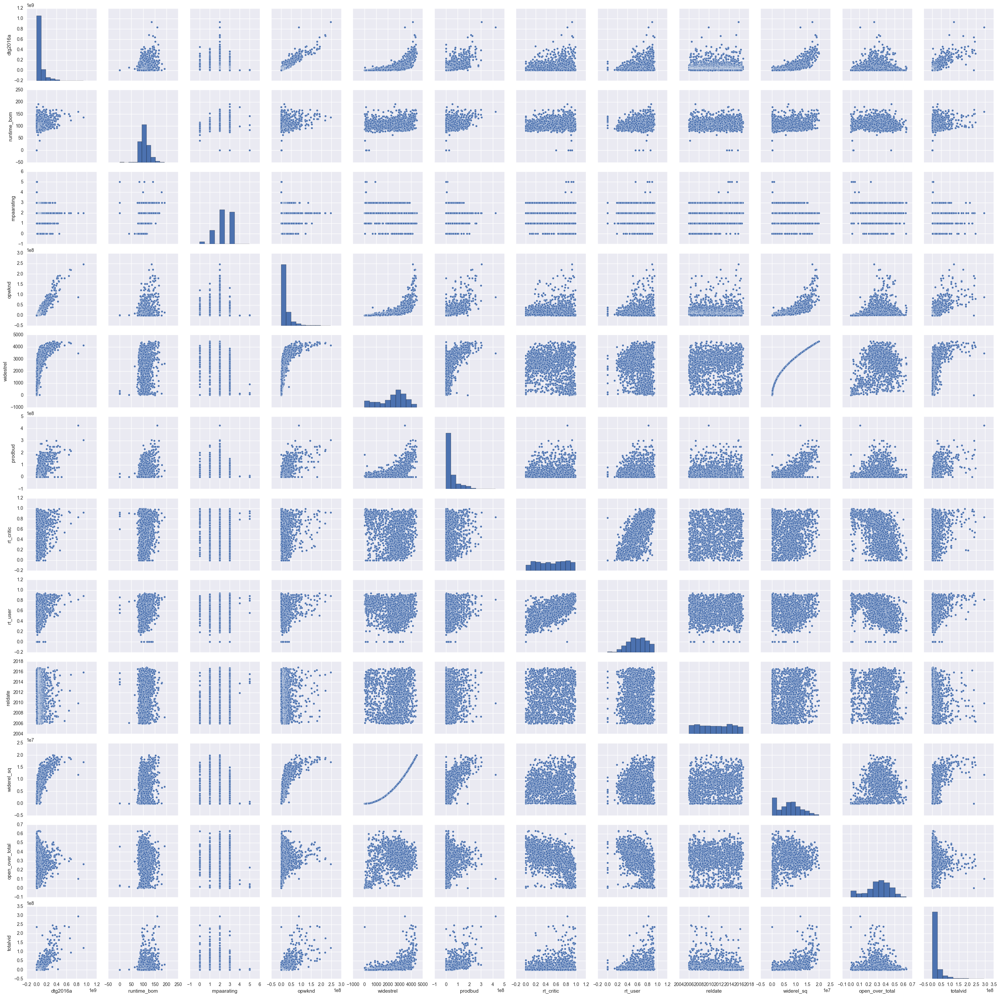

In [281]:
# Now let's try this again
sns.pairplot(df5[['dtg2016a', 'runtime_bom', 'mpaarating', 'opwknd', 'widestrel',
       'prodbud', 'rt_critic', 'rt_user', 'reldate', 'widerel_sq',
       'open_over_total', 'totalvid']])

In [72]:
def f_gauss(x):
    import math
    sigma = 0.15
    mu = 0.3
    lhs = 1/((2*3.14*sigma)**0.5)
    rhs = (-1/2)*((x-mu)/sigma)**2
    rhs = math.e**rhs
    return lhs*rhs

In [73]:
df5['oot_gauss'] = df5['open_over_total'].apply(f_gauss)

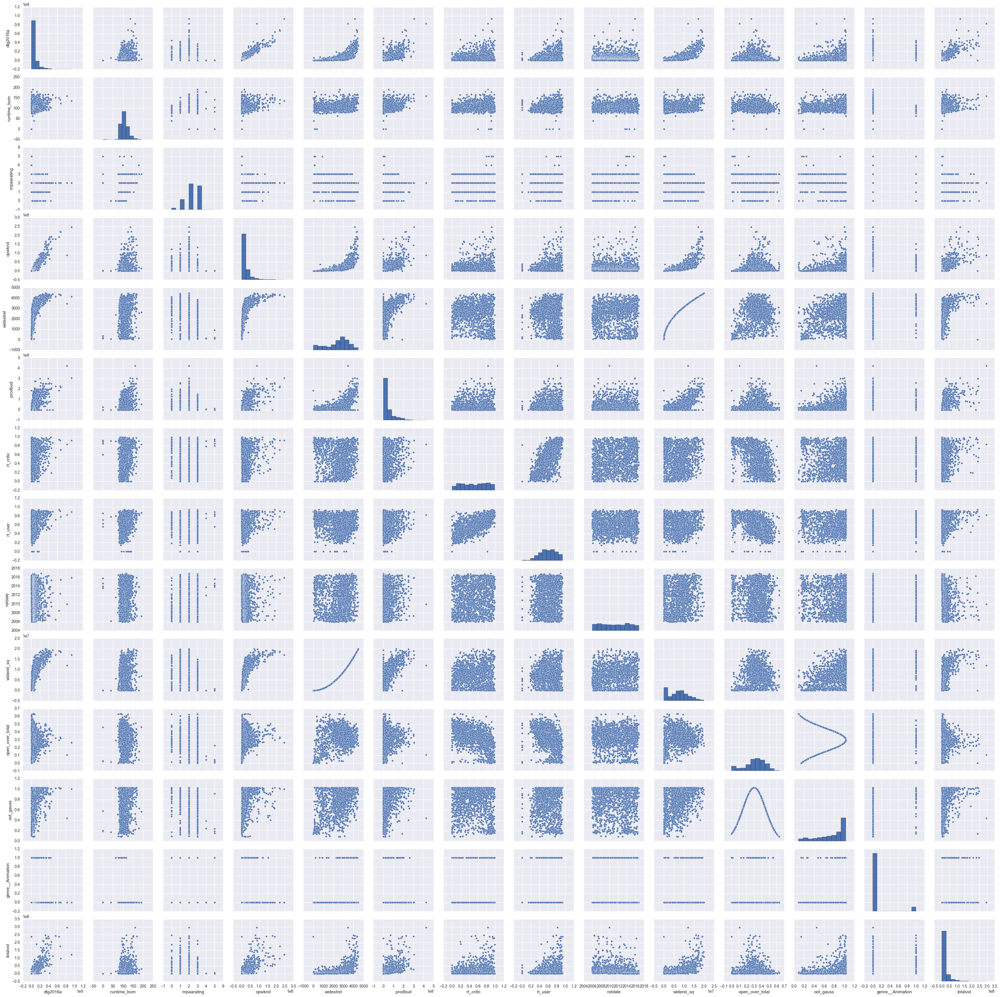

In [336]:
# Now let's try this again
sns.pairplot(df5[['dtg2016a', 'runtime_bom', 'mpaarating', 'opwknd', 'widestrel',
       'prodbud', 'rt_critic', 'rt_user', 'reldate', 'widerel_sq',
       'open_over_total', 'oot_gauss', 'genre__Animation', 'totalvid']])

In [190]:
df5[['dtg2016a', 'runtime_bom', 'mpaarating', 'opwknd', 'widestrel',
       'prodbud', 'rt_critic', 'rt_user', 'reldate', 'widerel_sq',
       'open_over_total', 'genre__Animation', 'totalvidlog10']].corr()

,dtg2016a,runtime_bom,mpaarating,opwknd,widestrel,prodbud,rt_critic,rt_user,reldate,widerel_sq,open_over_total,genre__Animation,totalvidlog10
dtg2016a,1.000000,0.288119,-0.206646,0.931643,0.612998,0.689315,0.183058,0.267354,-0.016488,0.710975,-0.027579,0.194899,0.616999
runtime_bom,0.288119,1.000000,0.165486,0.268214,0.112102,0.341731,0.213075,0.294794,0.072542,0.143434,-0.102049,-0.209014,0.234690
mpaarating,-0.206646,0.165486,1.000000,-0.173360,-0.282150,-0.243488,0.109319,-0.023837,0.082730,-0.307818,0.013354,-0.428114,-0.245124
opwknd,0.931643,0.268214,-0.173360,1.000000,0.631070,0.678924,0.096296,0.173548,0.000608,0.731052,0.151372,0.149428,0.576950
widestrel,0.612998,0.112102,-0.282150,0.631070,1.000000,0.602511,-0.198073,-0.132604,0.006853,0.965622,0.387746,0.216649,0.656568
prodbud,0.689315,0.341731,-0.243488,0.678924,0.602511,1.000000,0.051924,0.081285,0.027336,0.690091,0.065748,0.217187,0.535054
rt_critic,0.183058,0.213075,0.109319,0.096296,-0.198073,0.051924,1.000000,0.716411,0.125332,-0.112580,-0.517466,0.100444,0.012933
rt_user,0.267354,0.294794,-0.023837,0.173548,-0.132604,0.081285,0.716411,1.000000,0.029735,-0.056306,-0.472886,0.068605,0.175408
reldate,-0.016488,0.072542,0.082730,0.000608,0.006853,0.027336,0.125332,0.029735,1.000000,0.053493,-0.050122,-0.002046,-0.415311
widerel_sq,0.710975,0.143434,-0.307818,0.731052,0.965622,0.690091,-0.112580,-0.056306,0.053493,1.000000,0.273705,0.259798,0.646958


In [75]:
selected_columns_2 = df5.columns
selected_columns_2

Index(['dtg2016a', 'runtime_bom', 'mpaarating', 'opwknd', 'widestrel',
       'prodbud', 'totalvid', 'rt_critic', 'rt_user', 'reldate', 'widerel_sq',
       'genre__Action', 'genre__Action / Adventure', 'genre__Action Comedy',
       'genre__Action Drama', 'genre__Action Thriller', 'genre__Adventure',
       'genre__Animation', 'genre__Comedy', 'genre__Comedy / Drama',
       'genre__Crime Drama', 'genre__Documentary', 'genre__Drama',
       'genre__Drama / Thriller', 'genre__Family', 'genre__Family Adventure',
       'genre__Family Comedy', 'genre__Fantasy', 'genre__Fantasy Drama',
       'genre__Foreign', 'genre__Historical Drama', 'genre__Horror',
       'genre__Horror Comedy', 'genre__Horror Thriller', 'genre__Music Drama',
       'genre__Musical', 'genre__Period Drama', 'genre__Romance',
       'genre__Romantic Comedy', 'genre__Sci-Fi', 'genre__Sci-Fi Action',
       'genre__Sci-Fi Thriller', 'genre__Sports Comedy', 'genre__Sports Drama',
       'genre__Thriller', 'open_over_total

In [76]:
holdout_2 = df5[ df5['reldate'] >= 2016 ]
df6 = df5[ df5['reldate'] < 2016 ]

In [77]:
X_ho2,y_ho2 = holdout_2.drop('totalvid',axis=1),holdout['totalvid']

In [78]:
X2,y2 = df6.drop('totalvid', axis=1),df6['totalvid']

In [79]:
X_train2, X_test2, y_train2, y_test2 = train_test_split(X2, y2, test_size=0.3, random_state = 42)

In [298]:
df5.corr()

,dtg2016a,runtime_bom,mpaarating,opwknd,widestrel,prodbud,totalvid,rt_critic,rt_user,reldate,...,genre__Romance,genre__Romantic Comedy,genre__Sci-Fi,genre__Sci-Fi Action,genre__Sci-Fi Thriller,genre__Sports Comedy,genre__Sports Drama,genre__Thriller,open_over_total,oot_gauss
dtg2016a,1.000000,0.288119,-0.206646,0.931643,0.612998,0.689315,0.813047,0.183058,0.267354,-0.016488,...,0.024260,-0.019671,0.002299,0.121612,-0.014977,-0.001198,-0.017076,-0.075351,-0.027579,0.287891
runtime_bom,0.288119,1.000000,0.165486,0.268214,0.112102,0.341731,0.241989,0.213075,0.294794,0.072542,...,0.033251,-0.018715,0.054874,0.096603,-0.028741,-0.043091,0.053797,0.036386,-0.102049,0.073101
mpaarating,-0.206646,0.165486,1.000000,-0.173360,-0.282150,-0.243488,-0.224949,0.109319,-0.023837,0.082730,...,-0.028601,-0.000050,0.010814,0.003628,-0.005211,-0.008818,-0.093026,0.147267,0.013354,-0.244640
opwknd,0.931643,0.268214,-0.173360,1.000000,0.631070,0.678924,0.724186,0.096296,0.173548,0.000608,...,0.055659,-0.017250,0.006391,0.121560,-0.019820,0.003169,-0.038218,-0.060565,0.151372,0.278487
widestrel,0.612998,0.112102,-0.282150,0.631070,1.000000,0.602511,0.472785,-0.198073,-0.132604,0.006853,...,0.014026,0.012779,0.023685,0.101889,0.034217,0.025900,-0.010353,-0.026903,0.387746,0.550007
prodbud,0.689315,0.341731,-0.243488,0.678924,0.602511,1.000000,0.574562,0.051924,0.081285,0.027336,...,-0.022319,-0.054360,0.056530,0.175679,-0.004084,-0.016049,-0.042157,-0.061823,0.065748,0.294907
totalvid,0.813047,0.241989,-0.224949,0.724186,0.472785,0.574562,1.000000,0.166855,0.281791,-0.194664,...,0.025889,-0.016882,-0.018290,0.095921,-0.023035,0.013351,-0.001086,-0.083980,-0.057874,0.230543
rt_critic,0.183058,0.213075,0.109319,0.096296,-0.198073,0.051924,0.166855,1.000000,0.716411,0.125332,...,-0.072830,-0.108195,0.023231,0.018147,-0.020571,-0.034265,0.008820,-0.087140,-0.517466,-0.080779
rt_user,0.267354,0.294794,-0.023837,0.173548,-0.132604,0.081285,0.281791,0.716411,1.000000,0.029735,...,0.022146,-0.047010,-0.006415,0.015538,-0.027307,-0.029053,0.091820,-0.101222,-0.472886,0.011778
reldate,-0.016488,0.072542,0.082730,0.000608,0.006853,0.027336,-0.194664,0.125332,0.029735,1.000000,...,-0.004700,-0.084247,0.061369,0.041915,0.000582,-0.082063,-0.037340,0.040595,-0.050122,-0.051185


In [80]:
selected_columns_3 = ['opwknd','widerel_sq','prodbud','dtg2016a','oot_gauss']

In [81]:
lr_model3 = LinearRegression()
lr_model3.fit(X_train2.loc[:,selected_columns_3],y_train2)

LinearRegression(copy_X=True, fit_intercept=True, n_jobs=1, normalize=False)

In [82]:
#train_set_pred1 = lr_model1.predict(X_train.loc[:,selected_columns_1])
test_pred_lr3 = lr_model3.predict(X_test2.loc[:,selected_columns_3])

In [83]:
## linreg, just ['opwknd','widerel_sq','prodbud','dtg2016a','oot_gauss']
np.sqrt(np.mean((test_pred_lr3 - y_test2)**2))
# 19284397.579139106 # this
# 19282733.399299566 # best before this, lr2

19284397.579139106

In [84]:
lr_model3.coef_

array([ -4.22310926e-01,   1.44981620e-01,   1.87098106e-02,
         4.20820492e-01,   4.73448071e+05])

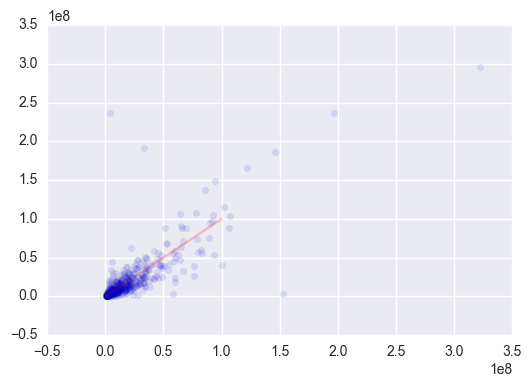

In [85]:
plt.scatter(test_pred_lr3,y_test2,alpha=.1)
plt.plot(np.linspace(0,100000000,1000),np.linspace(0,100000000,1000),color='red',alpha=0.2)

In [86]:
gbmodel6 = GradientBoostingRegressor(subsample = 0.9, n_estimators = 3000, random_state = 1000, 
                                     learning_rate = 0.001, min_samples_leaf = 16, max_depth=5)

# subsample = sampling just much of the data without replacement
'''

(loss='ls', learning_rate=0.1, n_estimators=100, subsample=1.0, criterion='friedman_mse', 
min_samples_split=2, min_samples_leaf=1, min_weight_fraction_leaf=0.0, max_depth=3, min_impurity_split=1e-07, 
init=None, random_state=None, max_features=None, alpha=0.9, verbose=0, max_leaf_nodes=None, warm_start=False, 
presort='auto')


'''

gbmodel6.fit(X_train2, y_train2)

GradientBoostingRegressor(alpha=0.9, criterion='friedman_mse', init=None,
             learning_rate=0.001, loss='ls', max_depth=5,
             max_features=None, max_leaf_nodes=None,
             min_impurity_split=1e-07, min_samples_leaf=16,
             min_samples_split=2, min_weight_fraction_leaf=0.0,
             n_estimators=3000, presort='auto', random_state=1000,
             subsample=0.9, verbose=0, warm_start=False)

In [87]:
for i in range(len(gbmodel6.feature_importances_)):
    if gbmodel6.feature_importances_[i] > 0.000001:
        print(X_train2.columns[i], gbmodel6.feature_importances_[i])

dtg2016a 0.618652066436
runtime_bom 0.01503796275
mpaarating 0.00759473581621
opwknd 0.0283313217897
widestrel 0.02110288581
prodbud 0.0416777816826
rt_critic 0.0134262454391
rt_user 0.054415709001
reldate 0.0950658176219
widerel_sq 0.0232798208637
genre__Action 0.00107484649142
genre__Action / Adventure 0.000739908979586
genre__Animation 0.0196000216675
genre__Comedy 0.00010454337385
genre__Comedy / Drama 2.94506933637e-05
genre__Fantasy 1.16843088968e-05
genre__Horror 0.000395629448416
open_over_total 0.0432250747175
oot_gauss 0.0162336528263


In [88]:
gb6_rank = pd.DataFrame()
gb6_rank['feature'] = X_train2.columns
gb6_rank['importance'] = gbmodel6.feature_importances_

gb6_rank.sort_values(['importance'], ascending=False)

,feature,importance
0,dtg2016a,6.186521e-01
8,reldate,9.506582e-02
7,rt_user,5.441571e-02
44,open_over_total,4.322507e-02
5,prodbud,4.167778e-02
3,opwknd,2.833132e-02
9,widerel_sq,2.327982e-02
4,widestrel,2.110289e-02
16,genre__Animation,1.960002e-02
45,oot_gauss,1.623365e-02


In [109]:
gbmodel6.feature_importances_.sum()

1.0000000000000004

In [89]:
# Use the trained model to predict the results on the test set

test_pred_gb6 = gbmodel6.predict(X_test2)

In [90]:
## gradientboosting: n_estimators = 3000, subsample = 0.9, learning_rate = 0.001, min_samples_leaf=16, max_depth=5
np.sqrt(np.mean((test_pred_gb6 - y_test2)**2))
# 19407900.678566162 # this
# 18893689.749674287 # best before this, gb3

19407900.678566162

In [91]:
# X_ho,y_ho

In [92]:
test_pred_lr1_ho = lr_model1.predict(X_ho)
np.sqrt(np.mean((test_pred_lr1_ho - y_ho)**2))

6043368847.0786295

In [93]:
test_pred_lr2_ho = lr_model2.predict(X_ho.loc[:,selected_columns_1])
np.sqrt(np.mean((test_pred_lr2_ho - y_ho)**2))

20569193.70167163

In [94]:
test_pred_lr3_ho = lr_model3.predict(X_ho2.loc[:,selected_columns_3])
np.sqrt(np.mean((test_pred_lr3_ho - y_ho2)**2))

20565943.030721676

In [95]:
test_pred_gb5_ho = gbmodel5.predict(X_ho)
np.sqrt(np.mean((test_pred_gb5_ho - y_ho)**2))

17651187.23410815

In [96]:
test_pred_gb6_ho = gbmodel6.predict(X_ho2)
np.sqrt(np.mean((test_pred_gb6_ho - y_ho2)**2))

17441430.530389279

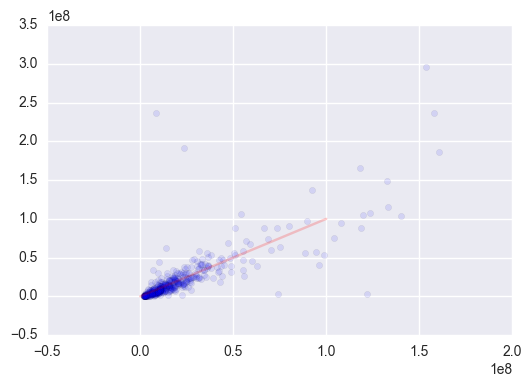

In [334]:
plt.scatter(test_pred_gb6,y_test,alpha=.1)
plt.plot(np.linspace(0,100000000,1000),np.linspace(0,100000000,1000),color='red',alpha=0.2)

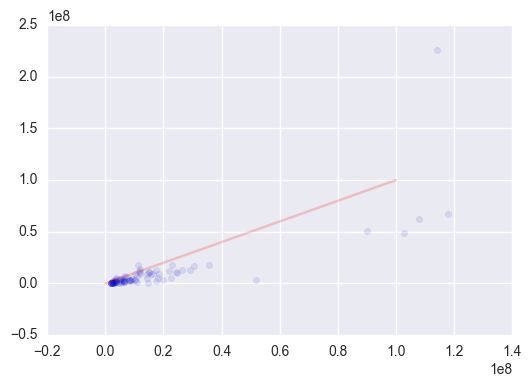

In [331]:
plt.scatter(test_pred_gb6_ho,y_ho2,alpha=.1)
plt.plot(np.linspace(0,100000000,1000),np.linspace(0,100000000,1000),color='red',alpha=0.2)

In [335]:
df6.head()

,dtg2016a,runtime_bom,mpaarating,opwknd,widestrel,prodbud,totalvid,rt_critic,rt_user,reldate,...,genre__Romance,genre__Romantic Comedy,genre__Sci-Fi,genre__Sci-Fi Action,genre__Sci-Fi Thriller,genre__Sports Comedy,genre__Sports Drama,genre__Thriller,open_over_total,oot_gauss
0,559035400,151,2,179120400.0,4133,225000000,2.425981e+08,0.54,0.72,2006.500000,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.320410,1.020832
1,320409800,108,1,40191200.0,3768,110000000,1.151701e+08,0.43,0.67,2006.916667,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.125437,0.523464
2,322338600,116,0,79394500.0,3988,70000000,2.463390e+08,0.74,0.79,2006.416667,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.246308,0.966389
3,309501600,104,2,135693600.0,3714,178000000,1.660389e+07,0.58,0.62,2006.333333,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.438426,0.673045
4,287280600,149,2,101783900.0,3757,125000000,7.516178e+07,0.25,0.57,2006.333333,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.354301,0.964978


In [97]:
# Make year and month columns
df5['year'] = df5['reldate'].apply(lambda x: int(x))
df5['year'].value_counts()

2014    172
2007    168
2013    160
2006    156
2008    155
2015    149
2009    140
2010    137
2011    135
2012    133
2016     91
Name: year, dtype: int64

In [98]:
df5['month'] = df5['reldate'].apply(lambda x: ((x-int(x))*12)+1 )
#df5['month'] = df5['month'].apply(int)
df5['month'].value_counts()

10.0    155
12.0    153
3.0     147
11.0    143
4.0     140
8.0     137
9.0     134
2.0     129
7.0     126
6.0     119
1.0     107
5.0     106
Name: month, dtype: int64

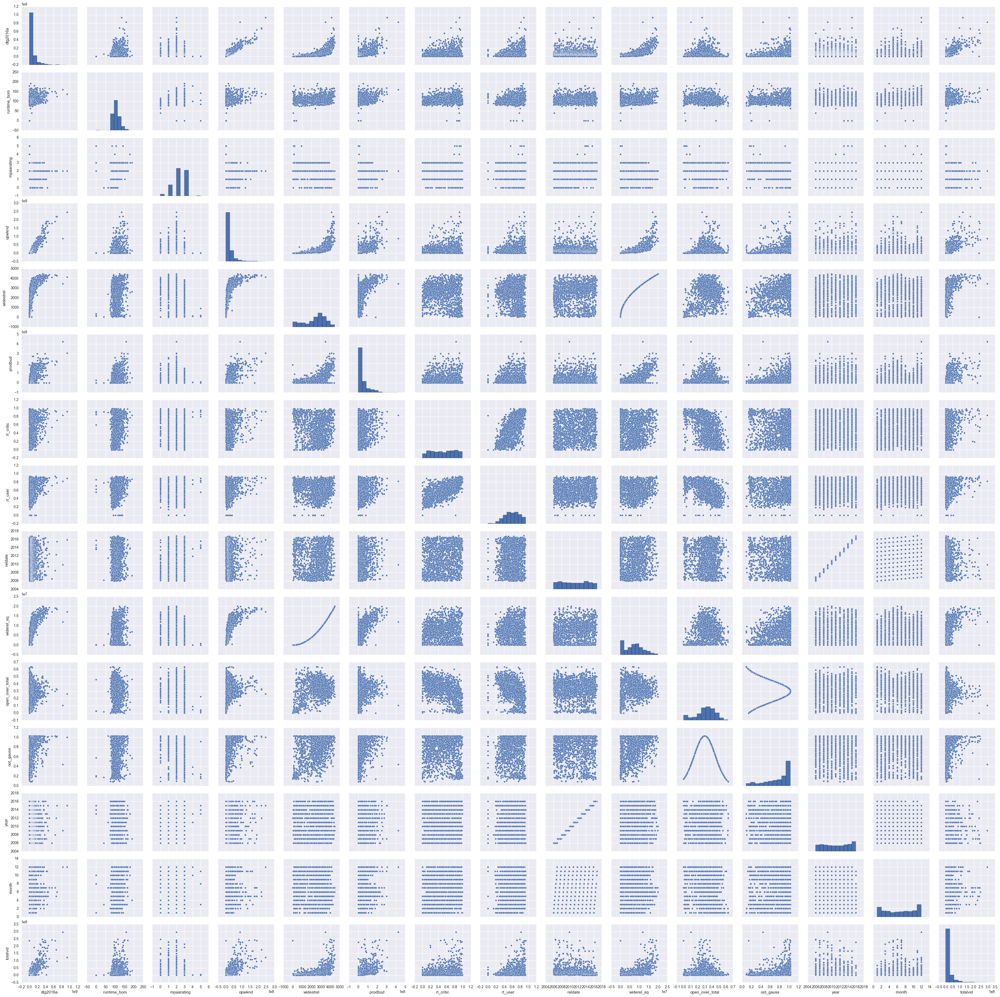

In [347]:
sns.pairplot(df5[['dtg2016a', 'runtime_bom', 'mpaarating', 'opwknd', 'widestrel',
       'prodbud', 'rt_critic', 'rt_user', 'reldate', 'widerel_sq',
       'open_over_total', 'oot_gauss', 'year', 'month', 'totalvid']])

In [346]:
df5[['dtg2016a', 'runtime_bom', 'mpaarating', 'opwknd', 'widestrel',
       'prodbud', 'rt_critic', 'rt_user', 'reldate', 'widerel_sq',
       'open_over_total', 'oot_gauss', 'year', 'month', 'totalvid']].corr()

,dtg2016a,runtime_bom,mpaarating,opwknd,widestrel,prodbud,rt_critic,rt_user,reldate,widerel_sq,open_over_total,oot_gauss,year,month,totalvid
dtg2016a,1.000000,0.288119,-0.206646,0.931643,0.612998,0.689315,0.183058,0.267354,-0.016488,0.710975,-0.027579,0.287891,-0.020400,0.042797,0.813047
runtime_bom,0.288119,1.000000,0.165486,0.268214,0.112102,0.341731,0.213075,0.294794,0.072542,0.143434,-0.102049,0.073101,0.058270,0.151336,0.241989
mpaarating,-0.206646,0.165486,1.000000,-0.173360,-0.282150,-0.243488,0.109319,-0.023837,0.082730,-0.307818,0.013354,-0.244640,0.078764,0.039802,-0.224949
opwknd,0.931643,0.268214,-0.173360,1.000000,0.631070,0.678924,0.096296,0.173548,0.000608,0.731052,0.151372,0.278487,0.004336,-0.040244,0.724186
widestrel,0.612998,0.112102,-0.282150,0.631070,1.000000,0.602511,-0.198073,-0.132604,0.006853,0.965622,0.387746,0.550007,0.012636,-0.062629,0.472785
prodbud,0.689315,0.341731,-0.243488,0.678924,0.602511,1.000000,0.051924,0.081285,0.027336,0.690091,0.065748,0.294907,0.023020,0.045578,0.574562
rt_critic,0.183058,0.213075,0.109319,0.096296,-0.198073,0.051924,1.000000,0.716411,0.125332,-0.112580,-0.517466,-0.080779,0.108515,0.176895,0.166855
rt_user,0.267354,0.294794,-0.023837,0.173548,-0.132604,0.081285,0.716411,1.000000,0.029735,-0.056306,-0.472886,0.011778,0.016333,0.143497,0.281791
reldate,-0.016488,0.072542,0.082730,0.000608,0.006853,0.027336,0.125332,0.029735,1.000000,0.053493,-0.050122,-0.051185,0.995694,0.010417,-0.194664
widerel_sq,0.710975,0.143434,-0.307818,0.731052,0.965622,0.690091,-0.112580,-0.056306,0.053493,1.000000,0.273705,0.491843,0.058010,-0.050654,0.558798


In [99]:
df7 = df5.copy()

In [100]:
holdout_3 = df7[ df7['reldate'] >= 2016 ]
df8 = df7[ df7['reldate'] < 2016 ]

In [101]:
X_ho3,y_ho3 = holdout_3.drop('totalvid',axis=1),holdout_3['totalvid']

In [102]:
X3,y3 = df8.drop('totalvid', axis=1),df8['totalvid']

In [103]:
X_train3, X_test3, y_train3, y_test3 = train_test_split(X3, y3, test_size=0.3, random_state = 42)

In [119]:
# We need to standardize
std = StandardScaler()
std.fit(X_train3)

StandardScaler(copy=True, with_mean=True, with_std=True)

In [120]:
X3_tr = std.transform(X_train3)
X3_te = std.transform(X_test3)

In [124]:
clf_model1 = Lasso(alpha=0.1,max_iter=100000,tol=0.001)
clf_model1.fit(X3_tr, y_train3)

Lasso(alpha=0.1, copy_X=True, fit_intercept=True, max_iter=100000,
   normalize=False, positive=False, precompute=False, random_state=None,
   selection='cyclic', tol=0.001, warm_start=False)

In [126]:
for i in range(len(clf_model1.coef_)):
    #if clf.coef_[i] > 0.000001:
    print(X_train3.columns[i], clf_model1.coef_[i])


# Doesn't really tell us much

dtg2016a 36872614.8418
runtime_bom 1391439.4263
mpaarating -118546.121466
opwknd -14664705.1949
widestrel -14558973.2584
prodbud -1247174.0686
rt_critic -1199455.09081
rt_user 3452847.27354
reldate -6321931.90105
widerel_sq 16559782.6234
genre__Action -18303.9006235
genre__Action / Adventure -502199.051131
genre__Action Comedy -981974.452139
genre__Action Drama 119062.972914
genre__Action Thriller -434443.456829
genre__Adventure -55119.8391816
genre__Animation 3008051.96872
genre__Comedy -1139157.6256
genre__Comedy / Drama -536983.429377
genre__Crime Drama 103885.535761
genre__Documentary -420732.424539
genre__Drama -1354688.0997
genre__Drama / Thriller -933384.704263
genre__Family 223679.591407
genre__Family Adventure -560390.607013
genre__Family Comedy -321108.340241
genre__Fantasy 570560.034738
genre__Fantasy Drama -274531.979933
genre__Foreign -374782.110795
genre__Historical Drama -736229.718605
genre__Horror -810488.770254
genre__Horror Comedy -379081.45633
genre__Horror Thriller

In [127]:
# Now we'll save the transformed

df5.to_csv('11-tformeddata.csv')

In [191]:
df5.to_csv('12-tformedlogdata.csv')

# Modeling with cleaned up data (after some transformations):

In [192]:
# imports
from __future__ import print_function, division
#from bs4 import BeautifulSoup

import os

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import ml_insights as mli

from datetime import datetime

import re # regular expressions
import requests
import math

%matplotlib inline

# modeling imports
from sklearn.cross_validation import train_test_split
from sklearn.ensemble import GradientBoostingRegressor
from sklearn.linear_model import Lasso
from sklearn.pipeline import make_pipeline
from sklearn.preprocessing import PolynomialFeatures
from sklearn.linear_model import LinearRegression
from sklearn.ensemble import RandomForestRegressor
from sklearn.grid_search import GridSearchCV
from sklearn.preprocessing import StandardScaler

In [205]:
df1 = pd.read_csv('12-tformedlogdata.csv')
df1 = df1.drop(df1.columns[0], axis=1)
df1.head()


,dtg2016a,runtime_bom,mpaarating,opwknd,widestrel,prodbud,totalvid,rt_critic,rt_user,reldate,...,genre__Musical,genre__Period Drama,genre__Romance,genre__Romantic Comedy,genre__Sci-Fi,genre__Sci-Fi Action,genre__Sci-Fi Thriller,genre__Sports Comedy,genre__Sports Drama,genre__Thriller
0,559035400,151,2,179120400.0,4133,225000000,2.425981e+08,0.54,0.72,2006.500000,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,320409800,108,1,40191200.0,3768,110000000,1.151701e+08,0.43,0.67,2006.916667,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,322338600,116,0,79394500.0,3988,70000000,2.463390e+08,0.74,0.79,2006.416667,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,309501600,104,2,135693600.0,3714,178000000,1.660389e+07,0.58,0.62,2006.333333,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,287280600,149,2,101783900.0,3757,125000000,7.516178e+07,0.25,0.57,2006.333333,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0


In [212]:
df1.drop(['totalvid'],axis=1,inplace=True)

In [213]:
holdout = df1[ df1['reldate'] >= 2016 ]
df2 = df1[ df1['reldate'] < 2016 ]

In [214]:
X_ho,y_ho = holdout.drop('totalvidlog10',axis=1),holdout['totalvidlog10']

In [215]:
X,y = df2.drop('totalvidlog10', axis=1),df2['totalvidlog10']

In [216]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state = 42)

In [217]:
gbmodel7 = GradientBoostingRegressor(subsample = 0.9, n_estimators = 3000, random_state = 1000, 
                                     learning_rate = 0.001, min_samples_leaf = 16, max_depth=5)

# subsample = sampling just much of the data without replacement
'''

(loss='ls', learning_rate=0.1, n_estimators=100, subsample=1.0, criterion='friedman_mse', 
min_samples_split=2, min_samples_leaf=1, min_weight_fraction_leaf=0.0, max_depth=3, min_impurity_split=1e-07, 
init=None, random_state=None, max_features=None, alpha=0.9, verbose=0, max_leaf_nodes=None, warm_start=False, 
presort='auto')


'''

gbmodel7.fit(X_train, y_train)

GradientBoostingRegressor(alpha=0.9, criterion='friedman_mse', init=None,
             learning_rate=0.001, loss='ls', max_depth=5,
             max_features=None, max_leaf_nodes=None,
             min_impurity_split=1e-07, min_samples_leaf=16,
             min_samples_split=2, min_weight_fraction_leaf=0.0,
             n_estimators=3000, presort='auto', random_state=1000,
             subsample=0.9, verbose=0, warm_start=False)

In [218]:
# Use the trained model to predict the results on the test set

test_pred_gb7 = gbmodel7.predict(X_test)

In [220]:
## gradientboosting: n_estimators = 3000, subsample = 0.9, learning_rate = 0.001, min_samples_leaf=16, max_depth=5
math.pow(10,np.sqrt(np.mean((test_pred_gb7 - y_test)**2)))
#np.sqrt(np.mean((test_pred_gb7 - y_test)**2))
# 1.9629125872079412 # this
# 1.9821908499703274 # best before this rf2

1.9629125872079412

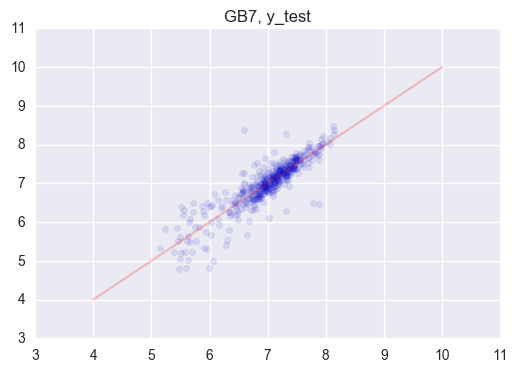

In [225]:
plt.scatter(test_pred_gb7,y_test,alpha=.1)
plt.plot(np.linspace(4,10,1000),np.linspace(4,10,1000),color='red',alpha=0.2)
plt.title('GB7, y_test')

In [221]:
test_pred_gb7_ho = gbmodel7.predict(X_ho)
math.pow(10,np.sqrt(np.mean((test_pred_gb7_ho - y_ho)**2)))
# 17441430.530389279 # gb6
# 17459906.659798555 # this

2.789860333354256

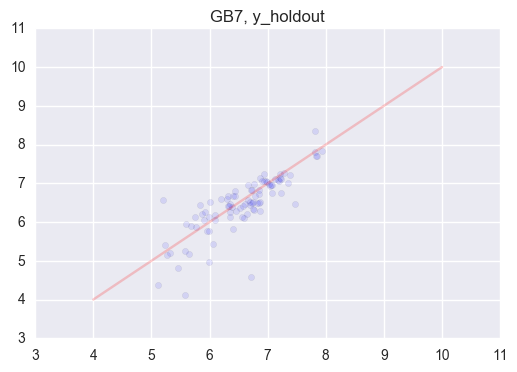

In [223]:
plt.scatter(test_pred_gb7_ho,y_ho,alpha=.1)
plt.plot(np.linspace(4,10,1000),np.linspace(4,10,1000),color='red',alpha=0.2)
plt.title('GB7, y_holdout')

In [226]:
gb7_rank = pd.DataFrame()
gb7_rank['feature'] = X_train.columns
gb7_rank['importance'] = gbmodel7.feature_importances_

gb7_rank.sort_values(['importance'], ascending=False)

,feature,importance
0,dtg2016a,0.420063
8,reldate,0.194056
3,opwknd,0.091252
7,rt_user,0.059876
5,prodbud,0.058187
13,open_over_total,0.032693
1,runtime_bom,0.030375
6,rt_critic,0.026028
12,month,0.016677
2,mpaarating,0.016345


In [227]:
featuresDrop = gb7_rank.sort_values(['importance'], ascending=False)[gb7_rank['importance'] < 0.00000001 ]['feature'].values
featuresDrop

/Users/ggarbagnati/anaconda/lib/python3.5/site-packages/ipykernel/__main__.py:1: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  if __name__ == '__main__':


array(['genre__Sci-Fi Thriller', 'genre__Sports Comedy',
       'genre__Horror Comedy', 'genre__Sci-Fi', 'genre__Sports Drama',
       'genre__Romance', 'genre__Period Drama', 'genre__Musical',
       'genre__Music Drama', 'genre__Horror Thriller',
       'genre__Sci-Fi Action', 'genre__Action Drama',
       'genre__Historical Drama', 'genre__Action Thriller',
       'genre__Fantasy Drama', 'genre__Fantasy', 'genre__Family Comedy',
       'genre__Family Adventure', 'genre__Family',
       'genre__Drama / Thriller', 'genre__Crime Drama',
       'genre__Action Comedy', 'genre__Adventure', 'genre__Foreign'], dtype=object)

In [228]:
df1.drop(featuresDrop,axis=1,inplace=True)

In [23]:
df1.head()

,dtg2016a,runtime_bom,mpaarating,opwknd,widestrel,prodbud,totalvid,rt_critic,rt_user,reldate,...,genre__Comedy,genre__Comedy / Drama,genre__Drama,genre__Fantasy,genre__Horror,genre__Thriller,open_over_total,oot_gauss,year,month
0,559035400,151,2,179120400.0,4133,225000000,2.425981e+08,0.54,0.72,2006.500000,...,0.0,0.0,0.0,0.0,0.0,0.0,0.320410,1.020832,2006,7.0
1,320409800,108,1,40191200.0,3768,110000000,1.151701e+08,0.43,0.67,2006.916667,...,0.0,0.0,0.0,0.0,0.0,0.0,0.125437,0.523464,2006,12.0
2,322338600,116,0,79394500.0,3988,70000000,2.463390e+08,0.74,0.79,2006.416667,...,0.0,0.0,0.0,0.0,0.0,0.0,0.246308,0.966389,2006,6.0
3,309501600,104,2,135693600.0,3714,178000000,1.660389e+07,0.58,0.62,2006.333333,...,0.0,0.0,0.0,0.0,0.0,0.0,0.438426,0.673045,2006,5.0
4,287280600,149,2,101783900.0,3757,125000000,7.516178e+07,0.25,0.57,2006.333333,...,0.0,0.0,0.0,0.0,0.0,1.0,0.354301,0.964978,2006,5.0


In [229]:
holdout = df1[ df1['reldate'] >= 2016 ]
df2 = df1[ df1['reldate'] < 2016 ]

In [230]:
X_ho,y_ho = holdout.drop('totalvidlog10',axis=1),holdout['totalvid']

ValueError: labels ['totalvid'] not contained in axis

In [231]:
X,y = df2.drop('totalvid', axis=1),df2['totalvid']

ValueError: labels ['totalvid'] not contained in axis

In [114]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state = 42)

In [142]:
gbmodel8 = GradientBoostingRegressor(subsample = 0.9, n_estimators = 3000, random_state = 1000, 
                                     learning_rate = 0.001, min_samples_leaf = 16, max_depth=5)

# subsample = sampling just much of the data without replacement
'''

(loss='ls', learning_rate=0.1, n_estimators=100, subsample=1.0, criterion='friedman_mse', 
min_samples_split=2, min_samples_leaf=1, min_weight_fraction_leaf=0.0, max_depth=3, min_impurity_split=1e-07, 
init=None, random_state=None, max_features=None, alpha=0.9, verbose=0, max_leaf_nodes=None, warm_start=False, 
presort='auto')


'''

gbmodel8.fit(X_train, y_train)

GradientBoostingRegressor(alpha=0.9, criterion='friedman_mse', init=None,
             learning_rate=0.001, loss='ls', max_depth=5,
             max_features=None, max_leaf_nodes=None,
             min_impurity_split=1e-07, min_samples_leaf=16,
             min_samples_split=2, min_weight_fraction_leaf=0.0,
             n_estimators=3000, presort='auto', random_state=1000,
             subsample=0.9, verbose=0, warm_start=False)

In [29]:
# Use the trained model to predict the results on the test set

test_pred_gb8 = gbmodel8.predict(X_test)

In [44]:
## gradientboosting: n_estimators = 3000, subsample = 0.9, learning_rate = 0.001, min_samples_leaf=16, max_depth=5
np.sqrt(np.mean((test_pred_gb8 - y_test)**2))
# 19397879.853615765 # this
# 19407900.678566162 # gbmodel6
# 18893689.749674287 # best before this, gb3

19396672.021771606

In [45]:
test_pred_gb8_ho = gbmodel8.predict(X_ho)
np.sqrt(np.mean((test_pred_gb8_ho - y_ho)**2))
# 17441430.530389279 # gb6
# 17459906.659798555 # this

17465067.647692751

In [32]:
gb8_rank = pd.DataFrame()
gb8_rank['feature'] = X_train.columns
gb8_rank['importance'] = gbmodel8.feature_importances_

gb8_rank.sort_values(['importance'], ascending=False)

,feature,importance
0,dtg2016a,6.178326e-01
8,reldate,8.874440e-02
7,rt_user,5.407853e-02
19,open_over_total,4.278254e-02
5,prodbud,4.109944e-02
3,opwknd,2.797025e-02
9,widerel_sq,2.241695e-02
4,widestrel,2.124861e-02
12,genre__Animation,1.963400e-02
20,oot_gauss,1.550964e-02


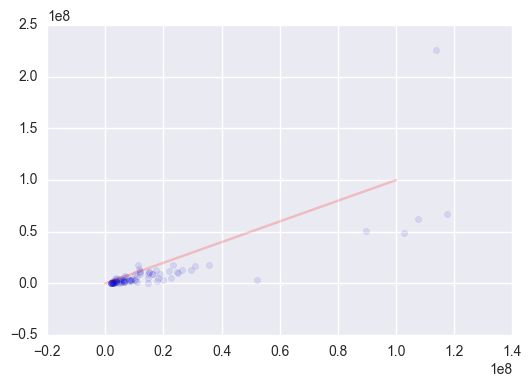

In [46]:
plt.scatter(test_pred_gb7_ho,y_ho,alpha=.1)
plt.plot(np.linspace(0,100000000,1000),np.linspace(0,100000000,1000),color='red',alpha=0.2)

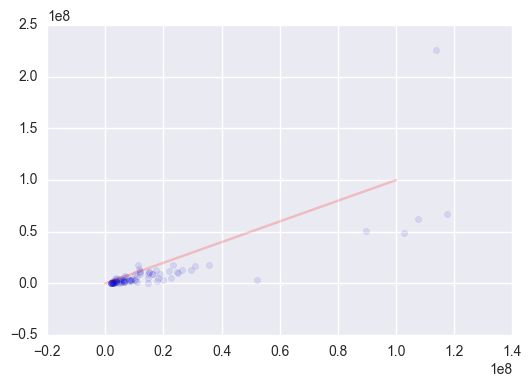

In [34]:
plt.scatter(test_pred_gb8_ho,y_ho,alpha=.1)
plt.plot(np.linspace(0,100000000,1000),np.linspace(0,100000000,1000),color='red',alpha=0.2)

In [234]:
# Modelling without dtg2016a

df3 = pd.read_csv('12-tformedlogdata.csv')
#df3 = pd.read_csv('11-tformeddata.csv')
df3 = df3.drop(df3.columns[0], axis=1)
df3.head()

,dtg2016a,runtime_bom,mpaarating,opwknd,widestrel,prodbud,totalvid,rt_critic,rt_user,reldate,...,genre__Musical,genre__Period Drama,genre__Romance,genre__Romantic Comedy,genre__Sci-Fi,genre__Sci-Fi Action,genre__Sci-Fi Thriller,genre__Sports Comedy,genre__Sports Drama,genre__Thriller
0,559035400,151,2,179120400.0,4133,225000000,2.425981e+08,0.54,0.72,2006.500000,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,320409800,108,1,40191200.0,3768,110000000,1.151701e+08,0.43,0.67,2006.916667,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,322338600,116,0,79394500.0,3988,70000000,2.463390e+08,0.74,0.79,2006.416667,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,309501600,104,2,135693600.0,3714,178000000,1.660389e+07,0.58,0.62,2006.333333,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,287280600,149,2,101783900.0,3757,125000000,7.516178e+07,0.25,0.57,2006.333333,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0


In [235]:
df3.columns

Index(['dtg2016a', 'runtime_bom', 'mpaarating', 'opwknd', 'widestrel',
       'prodbud', 'totalvid', 'rt_critic', 'rt_user', 'reldate', 'widerel_sq',
       'widerel_4th', 'year', 'month', 'open_over_total', 'totalvidlog10',
       'genre__Action', 'genre__Action / Adventure', 'genre__Action Comedy',
       'genre__Action Drama', 'genre__Action Thriller', 'genre__Adventure',
       'genre__Animation', 'genre__Comedy', 'genre__Comedy / Drama',
       'genre__Crime Drama', 'genre__Documentary', 'genre__Drama',
       'genre__Drama / Thriller', 'genre__Family', 'genre__Family Adventure',
       'genre__Family Comedy', 'genre__Fantasy', 'genre__Fantasy Drama',
       'genre__Foreign', 'genre__Historical Drama', 'genre__Horror',
       'genre__Horror Comedy', 'genre__Horror Thriller', 'genre__Music Drama',
       'genre__Musical', 'genre__Period Drama', 'genre__Romance',
       'genre__Romantic Comedy', 'genre__Sci-Fi', 'genre__Sci-Fi Action',
       'genre__Sci-Fi Thriller', 'genre__Sports

In [117]:
# BOOKMARK
# Putting 'totalvid' on a log scale
df3['totalvidlog10'] = df3['totalvid'].apply(math.log10)

In [236]:
df3 = df3.drop(['dtg2016a'], axis=1)
df3.head()

,runtime_bom,mpaarating,opwknd,widestrel,prodbud,totalvid,rt_critic,rt_user,reldate,widerel_sq,...,genre__Musical,genre__Period Drama,genre__Romance,genre__Romantic Comedy,genre__Sci-Fi,genre__Sci-Fi Action,genre__Sci-Fi Thriller,genre__Sports Comedy,genre__Sports Drama,genre__Thriller
0,151,2,179120400.0,4133,225000000,2.425981e+08,0.54,0.72,2006.500000,17081689,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,108,1,40191200.0,3768,110000000,1.151701e+08,0.43,0.67,2006.916667,14197824,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,116,0,79394500.0,3988,70000000,2.463390e+08,0.74,0.79,2006.416667,15904144,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,104,2,135693600.0,3714,178000000,1.660389e+07,0.58,0.62,2006.333333,13793796,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,149,2,101783900.0,3757,125000000,7.516178e+07,0.25,0.57,2006.333333,14115049,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0


In [237]:
holdout2 = df3[ df3['reldate'] >= 2016 ]
df3 = df3[ df3['reldate'] < 2016 ]

In [238]:
X_ho2,y_ho2 = holdout2.drop(['totalvid','totalvidlog10'],axis=1),holdout2['totalvidlog10']

In [239]:
X2,y2 = df3.drop(['totalvid','totalvidlog10'], axis=1),df3['totalvidlog10']

In [240]:
X2_train, X2_test, y2_train, y2_test = train_test_split(X2, y2, test_size=0.3, random_state = 42)

In [123]:
holdout2

,runtime_bom,mpaarating,opwknd,widestrel,prodbud,totalvid,rt_critic,rt_user,reldate,widerel_sq,...,genre__Sci-Fi Action,genre__Sci-Fi Thriller,genre__Sports Comedy,genre__Sports Drama,genre__Thriller,open_over_total,oot_gauss,year,month,totalvidlog10
1505,147,2,177497500.0,4226,250000000,4.922644e+07,0.90,0.89,2016.333333,17859076,...,0.0,0.0,0.0,0.0,0.0,0.438880,0.671165,2016,5.0,7.692198
1506,105,1,102315200.0,4144,0,2.260295e+08,0.95,0.87,2016.250000,17172736,...,0.0,0.0,0.0,0.0,0.0,0.283580,1.024171,2016,4.0,8.354165
1507,106,3,133515100.0,3856,58000000,6.268320e+07,0.84,0.90,2016.083333,14868736,...,0.0,0.0,0.0,0.0,0.0,0.364961,0.938099,2016,2.0,7.797151
1508,108,1,75675800.0,3959,150000000,6.723958e+07,0.98,0.92,2016.166667,15673681,...,0.0,0.0,0.0,0.0,0.0,0.220891,0.896555,2016,3.0,7.827625
1509,151,2,167361700.0,4256,250000000,5.033511e+07,0.27,0.64,2016.166667,18113536,...,0.0,0.0,0.0,0.0,0.0,0.505694,0.402384,2016,3.0,7.701871
1510,115,2,83703600.0,3882,0,2.961153e+06,0.90,0.89,2016.833333,15069924,...,0.0,0.0,0.0,0.0,0.0,0.367156,0.932072,2016,11.0,6.471461
1511,120,2,60228000.0,3928,185000000,1.012677e+07,0.84,0.81,2016.500000,15429184,...,0.0,0.0,0.0,0.0,0.0,0.373017,0.915208,2016,7.0,7.005471
1512,143,2,65166900.0,4153,178000000,1.660389e+07,0.48,0.68,2016.333333,17247409,...,0.0,0.0,0.0,0.0,0.0,0.422912,0.736501,2016,5.0,7.220210
1513,95,1,41618800.0,3987,140000000,1.820894e+07,0.87,0.79,2016.000000,15896169,...,0.0,0.0,0.0,0.0,0.0,0.287747,1.026894,2016,1.0,7.260285
1514,108,2,46775800.0,3963,144000000,1.755610e+07,0.73,0.53,2016.500000,15705369,...,0.0,0.0,0.0,0.0,0.0,0.358616,0.954586,2016,7.0,7.244428


In [124]:
lr_model4 = LinearRegression()
lr_model4.fit(X2_train,y2_train)

LinearRegression(copy_X=True, fit_intercept=True, n_jobs=1, normalize=False)

In [125]:
#train_set_pred1 = lr_model1.predict(X_train.loc[:,selected_columns_1])
test_pred_lr4 = lr_model4.predict(X2_test)

In [126]:
## linreg, just ['opwknd','widerel_sq','prodbud','dtg2016a','oot_gauss']
math.pow(10,np.sqrt(np.mean((test_pred_lr4 - y2_test)**2)))
# 21490351.000290494 # this
# 19282733.399299566 # best before this, lr2

2.05733318209886

In [88]:
gbmodel9 = GradientBoostingRegressor(subsample = 0.9, n_estimators = 3000, random_state = 1000, 
                                     learning_rate = 0.001, min_samples_leaf = 16, max_depth=5)

# subsample = sampling just much of the data without replacement
'''

(loss='ls', learning_rate=0.1, n_estimators=100, subsample=1.0, criterion='friedman_mse', 
min_samples_split=2, min_samples_leaf=1, min_weight_fraction_leaf=0.0, max_depth=3, min_impurity_split=1e-07, 
init=None, random_state=None, max_features=None, alpha=0.9, verbose=0, max_leaf_nodes=None, warm_start=False, 
presort='auto')


'''

gbmodel9.fit(X2_train, y2_train)

GradientBoostingRegressor(alpha=0.9, criterion='friedman_mse', init=None,
             learning_rate=0.001, loss='ls', max_depth=5,
             max_features=None, max_leaf_nodes=None,
             min_impurity_split=1e-07, min_samples_leaf=16,
             min_samples_split=2, min_weight_fraction_leaf=0.0,
             n_estimators=3000, presort='auto', random_state=1000,
             subsample=0.9, verbose=0, warm_start=False)

In [127]:
# Use the trained model to predict the results on the test set

test_pred_gb9 = gbmodel9.predict(X2_test)

In [128]:
## gradientboosting: n_estimators = 3000, subsample = 0.9, learning_rate = 0.001, min_samples_leaf=16, max_depth=5
math.pow( 10, np.sqrt(np.mean((test_pred_gb9 - y2_test)**2)) )
# 21490351.000290494 # lr4
# 19178232.945453681 # this

1.939774363441809

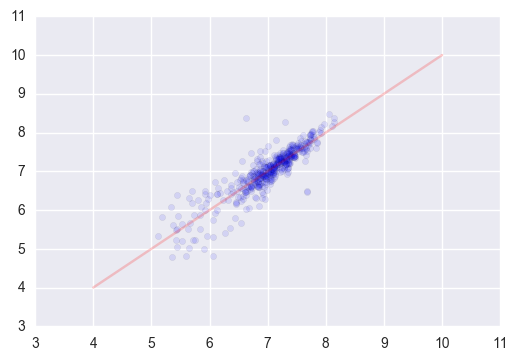

In [129]:
plt.scatter(test_pred_gb9,y2_test,alpha=.1)
#plt.plot(np.linspace(0,100000000,1000),np.linspace(0,100000000,1000),color='red',alpha=0.2)
plt.plot(np.linspace(4,10,1000),np.linspace(4,10,1000),color='red',alpha=0.2)

In [130]:
test_pred_gb9_ho = gbmodel9.predict(X_ho2)
math.pow(10,np.sqrt(np.mean((test_pred_gb9_ho - y_ho2)**2)))
# 21490351.000290494 # lr4
# 19178232.945453681 # this
# 17768652.699778836
# 2.754725025355635

2.754725025355635

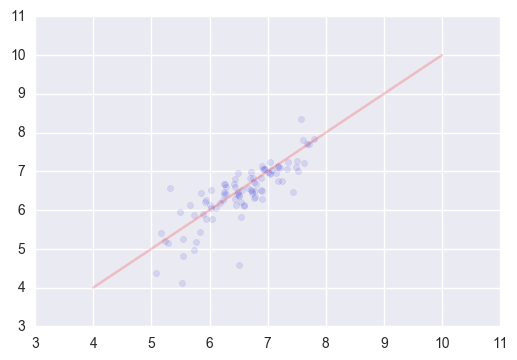

In [135]:
plt.scatter(test_pred_gb9_ho,y_ho2,alpha=.1)
plt.plot(np.linspace(4,10,10000),np.linspace(4,10,10000),color='red',alpha=0.2)
#plt.plot(np.linspace(0,100000000,1000),np.linspace(0,100000000,1000),color='red',alpha=0.2)

In [134]:
len(test_pred_gb9)

452

In [143]:
mxr1 = mli.ModelXRay(gbmodel8,X_test)


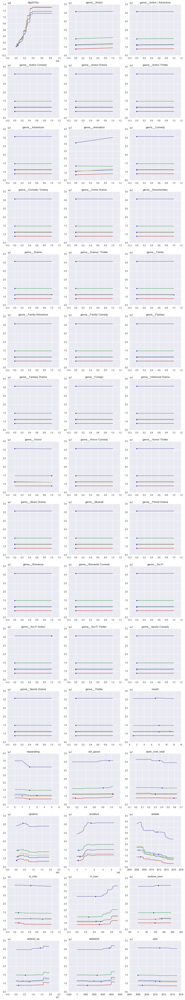

In [144]:
indices1 = mxr1.feature_dependence_plots(num_pts=5)

In [241]:
import ml_insights as mli

In [133]:
import ml_insights as mli
mxr = mli.ModelXRay(gbmodel9,X2_test)

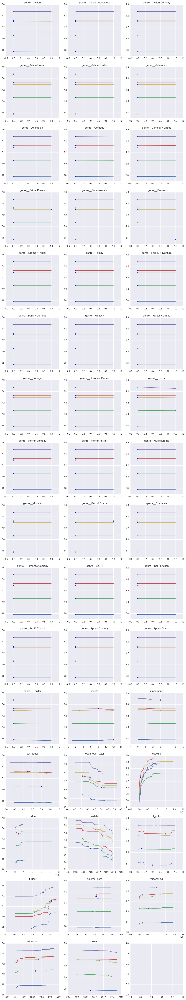

In [139]:
indices = mxr.feature_dependence_plots(num_pts=5)

In [242]:
holdout3 = holdout2.drop(['oot_gauss','open_over_total','opwknd'], axis=1).copy()
df4 = df3.drop(['oot_gauss','open_over_total','opwknd'], axis=1).copy()

ValueError: labels ['oot_gauss'] not contained in axis

In [243]:
holdout3 = holdout2.drop(['open_over_total','opwknd'], axis=1).copy()
df4 = df3.drop(['open_over_total','opwknd'], axis=1).copy()

In [244]:
X_ho3,y_ho3 = holdout3.drop(['totalvid','totalvidlog10'],axis=1),holdout3['totalvidlog10']

In [245]:
X3,y3 = df4.drop(['totalvid','totalvidlog10'], axis=1),df4['totalvidlog10']

In [246]:
X3_train, X3_test, y3_train, y3_test = train_test_split(X3, y3, test_size=0.3, random_state = 42)

In [247]:
gbmodel10 = GradientBoostingRegressor(subsample = 0.9, n_estimators = 3000, random_state = 1000, 
                                     learning_rate = 0.001, min_samples_leaf = 16, max_depth=5)

# subsample = sampling just much of the data without replacement
'''

(loss='ls', learning_rate=0.1, n_estimators=100, subsample=1.0, criterion='friedman_mse', 
min_samples_split=2, min_samples_leaf=1, min_weight_fraction_leaf=0.0, max_depth=3, min_impurity_split=1e-07, 
init=None, random_state=None, max_features=None, alpha=0.9, verbose=0, max_leaf_nodes=None, warm_start=False, 
presort='auto')


'''

gbmodel10.fit(X3_train, y3_train)

GradientBoostingRegressor(alpha=0.9, criterion='friedman_mse', init=None,
             learning_rate=0.001, loss='ls', max_depth=5,
             max_features=None, max_leaf_nodes=None,
             min_impurity_split=1e-07, min_samples_leaf=16,
             min_samples_split=2, min_weight_fraction_leaf=0.0,
             n_estimators=3000, presort='auto', random_state=1000,
             subsample=0.9, verbose=0, warm_start=False)

In [248]:
# Use the trained model to predict the results on the test set

test_pred_gb10 = gbmodel10.predict(X3_test)

In [249]:
## gradientboosting: n_estimators = 3000, subsample = 0.9, learning_rate = 0.001, min_samples_leaf=16, max_depth=5
math.pow( 10, np.sqrt(np.mean((test_pred_gb10 - y3_test)**2)) )
# 21490351.000290494 # lr4
# 19178232.945453681 # this

2.044154254244497

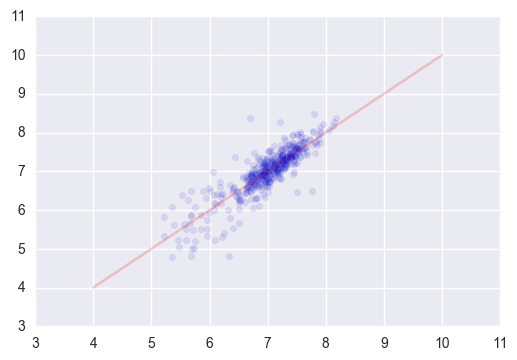

In [250]:
plt.scatter(test_pred_gb10,y3_test,alpha=.1)
#plt.plot(np.linspace(0,100000000,1000),np.linspace(0,100000000,1000),color='red',alpha=0.2)
plt.plot(np.linspace(4,10,1000),np.linspace(4,10,1000),color='red',alpha=0.2)

In [155]:
test_pred_gb10_ho = gbmodel10.predict(X_ho3)
math.pow(10,np.sqrt(np.mean((test_pred_gb10_ho - y_ho2)**3)))
# 21490351.000290494 # lr4
# 19178232.945453681 # this
# 17768652.699778836
# 2.754725025355635

2.2671081055209084

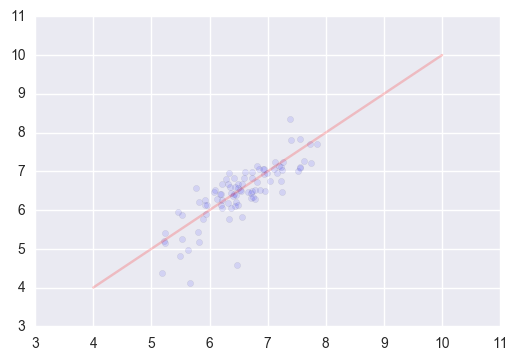

In [156]:
plt.scatter(test_pred_gb10_ho,y_ho3,alpha=.1)
plt.plot(np.linspace(4,10,10000),np.linspace(4,10,10000),color='red',alpha=0.2)
#plt.plot(np.linspace(0,100000000,1000),np.linspace(0,100000000,1000),color='red',alpha=0.2)

In [157]:

mxr2 = mli.ModelXRay(gbmodel10,X3_test)

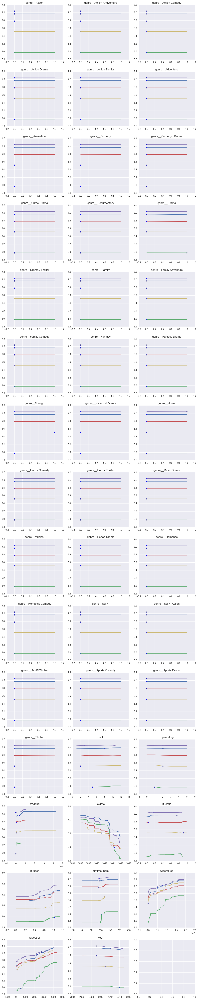

In [159]:
indices2 = mxr2.feature_dependence_plots(num_pts=5)

In [160]:
df4.columns

Index(['runtime_bom', 'mpaarating', 'widestrel', 'prodbud', 'totalvid',
       'rt_critic', 'rt_user', 'reldate', 'widerel_sq', 'genre__Action',
       'genre__Action / Adventure', 'genre__Action Comedy',
       'genre__Action Drama', 'genre__Action Thriller', 'genre__Adventure',
       'genre__Animation', 'genre__Comedy', 'genre__Comedy / Drama',
       'genre__Crime Drama', 'genre__Documentary', 'genre__Drama',
       'genre__Drama / Thriller', 'genre__Family', 'genre__Family Adventure',
       'genre__Family Comedy', 'genre__Fantasy', 'genre__Fantasy Drama',
       'genre__Foreign', 'genre__Historical Drama', 'genre__Horror',
       'genre__Horror Comedy', 'genre__Horror Thriller', 'genre__Music Drama',
       'genre__Musical', 'genre__Period Drama', 'genre__Romance',
       'genre__Romantic Comedy', 'genre__Sci-Fi', 'genre__Sci-Fi Action',
       'genre__Sci-Fi Thriller', 'genre__Sports Comedy', 'genre__Sports Drama',
       'genre__Thriller', 'year', 'month', 'totalvidlog10'],
   

In [251]:
holdout4 = holdout3.drop(['reldate', 'widerel_sq', 'genre__Action',
       'genre__Action / Adventure', 'genre__Action Comedy',
       'genre__Action Drama', 'genre__Action Thriller', 'genre__Adventure',
       'genre__Animation', 'genre__Comedy', 'genre__Comedy / Drama',
       'genre__Crime Drama', 'genre__Documentary', 'genre__Drama',
       'genre__Drama / Thriller', 'genre__Family', 'genre__Family Adventure',
       'genre__Family Comedy', 'genre__Fantasy', 'genre__Fantasy Drama',
       'genre__Foreign', 'genre__Historical Drama', 'genre__Horror',
       'genre__Horror Comedy', 'genre__Horror Thriller', 'genre__Music Drama',
       'genre__Musical', 'genre__Period Drama', 'genre__Romance',
       'genre__Romantic Comedy', 'genre__Sci-Fi', 'genre__Sci-Fi Action',
       'genre__Sci-Fi Thriller', 'genre__Sports Comedy', 'genre__Sports Drama',
       'genre__Thriller', 'year'], axis=1).copy()
df5 = df4.drop(['reldate', 'widerel_sq', 'genre__Action',
       'genre__Action / Adventure', 'genre__Action Comedy',
       'genre__Action Drama', 'genre__Action Thriller', 'genre__Adventure',
       'genre__Animation', 'genre__Comedy', 'genre__Comedy / Drama',
       'genre__Crime Drama', 'genre__Documentary', 'genre__Drama',
       'genre__Drama / Thriller', 'genre__Family', 'genre__Family Adventure',
       'genre__Family Comedy', 'genre__Fantasy', 'genre__Fantasy Drama',
       'genre__Foreign', 'genre__Historical Drama', 'genre__Horror',
       'genre__Horror Comedy', 'genre__Horror Thriller', 'genre__Music Drama',
       'genre__Musical', 'genre__Period Drama', 'genre__Romance',
       'genre__Romantic Comedy', 'genre__Sci-Fi', 'genre__Sci-Fi Action',
       'genre__Sci-Fi Thriller', 'genre__Sports Comedy', 'genre__Sports Drama',
       'genre__Thriller', 'year'], axis=1).copy()

In [252]:
X_ho4,y_ho4 = holdout4.drop(['totalvid','totalvidlog10'],axis=1),holdout4['totalvidlog10']

In [253]:
X4,y4 = df5.drop(['totalvid','totalvidlog10'], axis=1),df5['totalvidlog10']

In [254]:
X4_train, X4_test, y4_train, y4_test = train_test_split(X4, y4, test_size=0.3, random_state = 42)

In [255]:
gbmodel11 = GradientBoostingRegressor(subsample = 0.9, n_estimators = 3000, random_state = 1000, 
                                     learning_rate = 0.001, min_samples_leaf = 16, max_depth=5)

# subsample = sampling just much of the data without replacement
'''

(loss='ls', learning_rate=0.1, n_estimators=100, subsample=1.0, criterion='friedman_mse', 
min_samples_split=2, min_samples_leaf=1, min_weight_fraction_leaf=0.0, max_depth=3, min_impurity_split=1e-07, 
init=None, random_state=None, max_features=None, alpha=0.9, verbose=0, max_leaf_nodes=None, warm_start=False, 
presort='auto')


'''

gbmodel11.fit(X4_train, y4_train)

GradientBoostingRegressor(alpha=0.9, criterion='friedman_mse', init=None,
             learning_rate=0.001, loss='ls', max_depth=5,
             max_features=None, max_leaf_nodes=None,
             min_impurity_split=1e-07, min_samples_leaf=16,
             min_samples_split=2, min_weight_fraction_leaf=0.0,
             n_estimators=3000, presort='auto', random_state=1000,
             subsample=0.9, verbose=0, warm_start=False)

In [256]:
# Use the trained model to predict the results on the test set

test_pred_gb11 = gbmodel11.predict(X4_test)

In [257]:
## gradientboosting: n_estimators = 3000, subsample = 0.9, learning_rate = 0.001, min_samples_leaf=16, max_depth=5
math.pow( 10, np.sqrt(np.mean((test_pred_gb11 - y4_test)**2)) )
# 21490351.000290494 # lr4
# 19178232.945453681 # this

2.5012906997392617

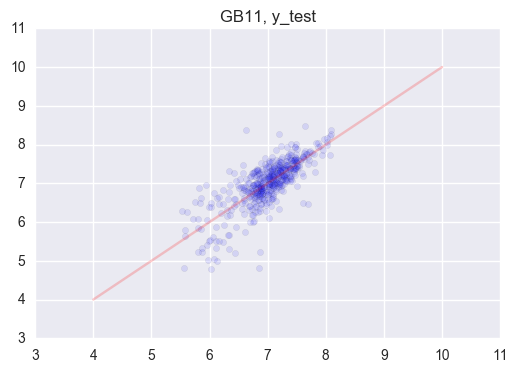

In [258]:
plt.scatter(test_pred_gb11,y4_test,alpha=.1)
#plt.plot(np.linspace(0,100000000,1000),np.linspace(0,100000000,1000),color='red',alpha=0.2)
plt.plot(np.linspace(4,10,1000),np.linspace(4,10,1000),color='red',alpha=0.2)
plt.title('GB11, y_test')

In [259]:
test_pred_gb11_ho = gbmodel11.predict(X_ho4)
math.pow(10,np.sqrt(np.mean((test_pred_gb11_ho - y_ho4)**2)))
# 21490351.000290494 # lr4
# 19178232.945453681 # this
# 17768652.699778836
# 2.754725025355635

5.622063153152097

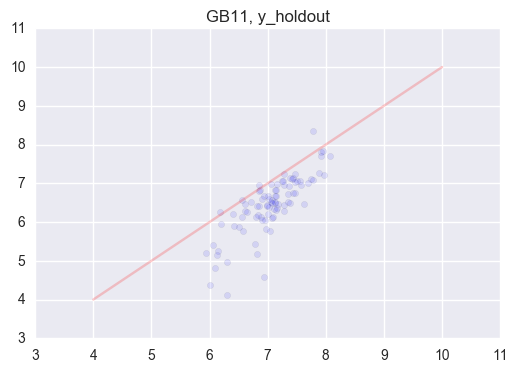

In [260]:
plt.scatter(test_pred_gb11_ho,y_ho4,alpha=.1)
plt.plot(np.linspace(4,10,10000),np.linspace(4,10,10000),color='red',alpha=0.2)
#plt.plot(np.linspace(0,100000000,1000),np.linspace(0,100000000,1000),color='red',alpha=0.2)
plt.title('GB11, y_holdout')

In [173]:

mxr3 = mli.ModelXRay(gbmodel11,X4_test)

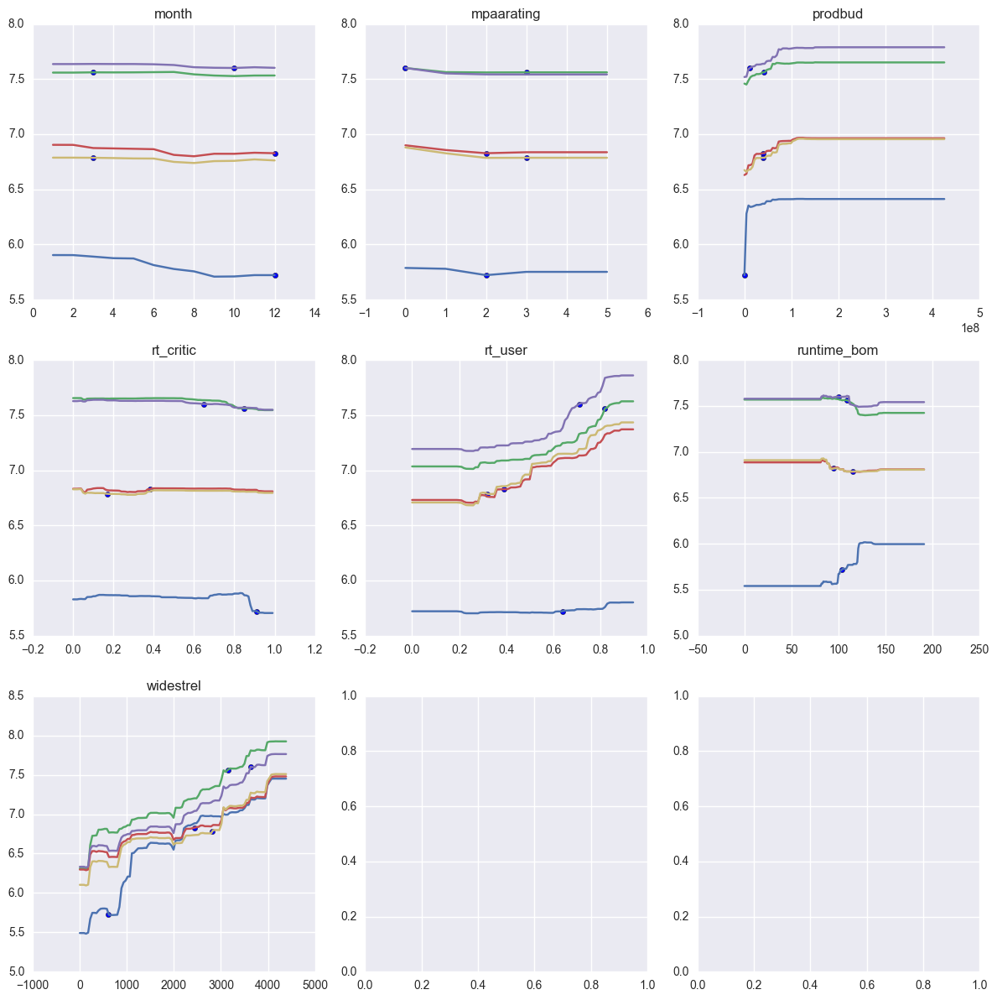

In [176]:
indices3 = mxr3.feature_dependence_plots(num_pts=5)

In [177]:
gb11_rank = pd.DataFrame()
gb11_rank['feature'] = X4_train.columns
gb11_rank['importance'] = gbmodel11.feature_importances_

gb11_rank.sort_values(['importance'], ascending=False)

,feature,importance
2,widestrel,0.458653
3,prodbud,0.152475
5,rt_user,0.140569
0,runtime_bom,0.098225
4,rt_critic,0.073198
6,month,0.048768
1,mpaarating,0.028112


In [254]:
# This and the next three cells were repeated changing the different hyper parameters to optimize

ne_range = [500]
#mss_range = list(range(4, 8))
mss_range = [2]
msl_range = [2]
mf_range = ['auto']
ss_range = [1.0]
lr_range = [0.005]
md_range = [3,4,5,6,7]

param_grid = dict(n_estimators=ne_range, min_samples_split=mss_range, min_samples_leaf=msl_range, 
                  max_features=mf_range, subsample=ss_range, learning_rate=lr_range, max_depth=md_range)
gbr = GradientBoostingRegressor()
print(param_grid)


{'max_depth': [3, 4, 5, 6, 7], 'learning_rate': [0.005], 'max_features': ['auto'], 'min_samples_leaf': [2], 'n_estimators': [500], 'subsample': [1.0], 'min_samples_split': [2]}


In [255]:
#grid = GridSearchCV(RandomForestRegressor, param_grid, cv=10, scoring='accuracy')
grid = GridSearchCV(gbr, param_grid, cv=10)
# fit the grid with data
grid.fit(X4_test, y4_test)



GridSearchCV(cv=10, error_score='raise',
       estimator=GradientBoostingRegressor(alpha=0.9, criterion='friedman_mse', init=None,
             learning_rate=0.1, loss='ls', max_depth=3, max_features=None,
             max_leaf_nodes=None, min_impurity_split=1e-07,
             min_samples_leaf=1, min_samples_split=2,
             min_weight_fraction_leaf=0.0, n_estimators=100,
             presort='auto', random_state=None, subsample=1.0, verbose=0,
             warm_start=False),
       fit_params={}, iid=True, n_jobs=1,
       param_grid={'max_depth': [3, 4, 5, 6, 7], 'learning_rate': [0.005], 'max_features': ['auto'], 'min_samples_leaf': [2], 'n_estimators': [500], 'subsample': [1.0], 'min_samples_split': [2]},
       pre_dispatch='2*n_jobs', refit=True, scoring=None, verbose=0)

In [256]:

os.system('afplay /System/Library/Sounds/Sosumi.aiff')
#os.system('afplay /System/Library/Sounds/Sosumi.aiff')
#os.system('afplay /System/Library/Sounds/Sosumi.aiff')

md = grid.grid_scores_
grid.grid_scores_

[mean: 0.56199, std: 0.06916, params: {'min_samples_leaf': 2, 'learning_rate': 0.005, 'max_features': 'auto', 'max_depth': 3, 'n_estimators': 500, 'subsample': 1.0, 'min_samples_split': 2},
 mean: 0.54957, std: 0.07128, params: {'min_samples_leaf': 2, 'learning_rate': 0.005, 'max_features': 'auto', 'max_depth': 4, 'n_estimators': 500, 'subsample': 1.0, 'min_samples_split': 2},
 mean: 0.51856, std: 0.08166, params: {'min_samples_leaf': 2, 'learning_rate': 0.005, 'max_features': 'auto', 'max_depth': 5, 'n_estimators': 500, 'subsample': 1.0, 'min_samples_split': 2},
 mean: 0.50046, std: 0.08138, params: {'min_samples_leaf': 2, 'learning_rate': 0.005, 'max_features': 'auto', 'max_depth': 6, 'n_estimators': 500, 'subsample': 1.0, 'min_samples_split': 2},
 mean: 0.48323, std: 0.08755, params: {'min_samples_leaf': 2, 'learning_rate': 0.005, 'max_features': 'auto', 'max_depth': 7, 'n_estimators': 500, 'subsample': 1.0, 'min_samples_split': 2}]

In [257]:
# nest = 500
# nest2 = 100
# mss = 5
# mss2 = 5
# msl = 2
# msl2 = 2
# mf = 3
# ss = 1
# lr = 0.005
# lr2 = 0.005
# md = 3

In [258]:
print(grid.best_score_)
print(grid.best_params_)
print(grid.best_estimator_)

0.5619859222732598
{'min_samples_leaf': 2, 'learning_rate': 0.005, 'max_features': 'auto', 'max_depth': 3, 'n_estimators': 500, 'subsample': 1.0, 'min_samples_split': 2}
GradientBoostingRegressor(alpha=0.9, criterion='friedman_mse', init=None,
             learning_rate=0.005, loss='ls', max_depth=3,
             max_features='auto', max_leaf_nodes=None,
             min_impurity_split=1e-07, min_samples_leaf=2,
             min_samples_split=2, min_weight_fraction_leaf=0.0,
             n_estimators=500, presort='auto', random_state=None,
             subsample=1.0, verbose=0, warm_start=False)


In [251]:
gbmodel12 = GradientBoostingRegressor(random_state=1000)

# subsample = sampling just much of the data without replacement
'''

(loss='ls', learning_rate=0.1, n_estimators=100, subsample=1.0, criterion='friedman_mse', 
min_samples_split=2, min_samples_leaf=1, min_weight_fraction_leaf=0.0, max_depth=3, min_impurity_split=1e-07, 
init=None, random_state=None, max_features=None, alpha=0.9, verbose=0, max_leaf_nodes=None, warm_start=False, 
presort='auto')


'''

gbmodel12.fit(X4_train, y4_train)

GradientBoostingRegressor(alpha=0.9, criterion='friedman_mse', init=None,
             learning_rate=0.1, loss='ls', max_depth=3, max_features=None,
             max_leaf_nodes=None, min_impurity_split=1e-07,
             min_samples_leaf=1, min_samples_split=2,
             min_weight_fraction_leaf=0.0, n_estimators=100,
             presort='auto', random_state=1000, subsample=1.0, verbose=0,
             warm_start=False)

In [252]:
# Use the trained model to predict the results on the test set

test_pred_gb12 = gbmodel12.predict(X4_test)

In [253]:
## gradientboosting: n_estimators = 3000, subsample = 0.9, learning_rate = 0.001, min_samples_leaf=16, max_depth=5
math.pow( 10, np.sqrt(np.mean((test_pred_gb12 - y4_test)**2)) )
# 21490351.000290494 # lr4
# 19178232.945453681 # this

2.4526201816266684

In [259]:
gbmodel13 = GradientBoostingRegressor(random_state=1000, n_estimators=100, min_samples_split=5, min_samples_leaf=2,
                                     max_features = 3, subsample=1.0, learning_rate=0.005, max_depth =3)

# subsample = sampling just much of the data without replacement
'''
# nest = 500
# nest2 = 100
# mss = 5
# mss2 = 5
# msl = 2
# msl2 = 2
# mf = 3
# ss = 1
# lr = 0.005
# lr2 = 0.005

(loss='ls', learning_rate=0.1, n_estimators=100, subsample=1.0, criterion='friedman_mse', 
min_samples_split=2, min_samples_leaf=1, min_weight_fraction_leaf=0.0, max_depth=3, min_impurity_split=1e-07, 
init=None, random_state=None, max_features=None, alpha=0.9, verbose=0, max_leaf_nodes=None, warm_start=False, 
presort='auto')


'''

gbmodel13.fit(X4_train, y4_train)

GradientBoostingRegressor(alpha=0.9, criterion='friedman_mse', init=None,
             learning_rate=0.005, loss='ls', max_depth=3, max_features=3,
             max_leaf_nodes=None, min_impurity_split=1e-07,
             min_samples_leaf=2, min_samples_split=5,
             min_weight_fraction_leaf=0.0, n_estimators=100,
             presort='auto', random_state=1000, subsample=1.0, verbose=0,
             warm_start=False)

In [260]:
# Use the trained model to predict the results on the test set

test_pred_gb13 = gbmodel13.predict(X4_test)

In [261]:
## gradientboosting: n_estimators = 3000, subsample = 0.9, learning_rate = 0.001, min_samples_leaf=16, max_depth=5
math.pow( 10, np.sqrt(np.mean((test_pred_gb13 - y4_test)**2)) )
# 21490351.000290494 # lr4
# 19178232.945453681 # this

3.250140209933017

In [270]:
test_pred_gb12_ho = gbmodel12.predict(X_ho4)
math.pow(10,np.sqrt(np.mean((test_pred_gb12_ho - y_ho4)**2)))

5.706378203129871

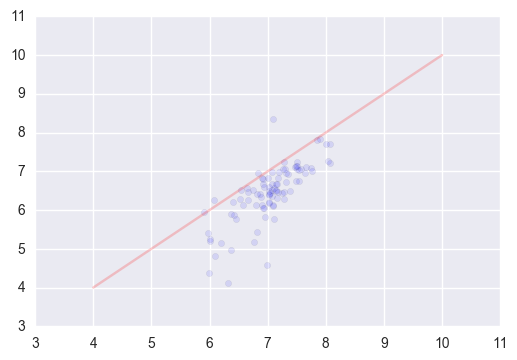

In [271]:
plt.scatter(test_pred_gb12_ho,y_ho4,alpha=.1)
plt.plot(np.linspace(4,10,10000),np.linspace(4,10,10000),color='red',alpha=0.2)

In [272]:
test_pred_gb13_ho = gbmodel13.predict(X_ho4)
math.pow(10,np.sqrt(np.mean((test_pred_gb13_ho - y_ho4)**2)))

6.875805845078146

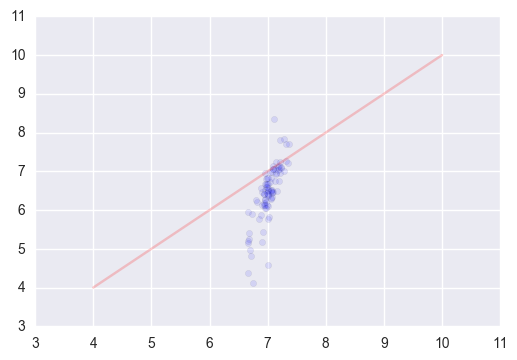

In [273]:
plt.scatter(test_pred_gb13_ho,y_ho4,alpha=.1)
plt.plot(np.linspace(4,10,10000),np.linspace(4,10,10000),color='red',alpha=0.2)